In [1]:
%matplotlib inline

In [2]:
from datetime import datetime
import os
from os.path import dirname, abspath, join
from os import getcwd
import sys

In [3]:
import random
import string
import pandas as pd
import numpy as np

In [4]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker

In [5]:
import torch
import socket
from IPython.display import clear_output

In [6]:
# seed_arg = int(sys.argv[1])
# print ("\n\nSeed ARG: ",seed_arg)
seed_arg = 1

In [7]:
seedlist = np.array([161, 314, 228, 271828, 230, 4271031, 5526538, 6610165, 9849252, 34534, 73422, 8765])
seed = seedlist[seed_arg]
random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)
np.random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)

In [8]:
NAME       = 'G_aomori'
MODELNAME  = NAME + '_' + str(seed) + '.pt'
print("\nMODEL : ", NAME)
print("SEED  : ",seed_arg)
print("HOST  : ",socket.gethostname())
print("START : ",datetime.now())


MODEL :  G_aomori
SEED  :  1
HOST  :  7574709303cc
START :  2019-03-18 00:28:18.607505


In [9]:
class ENO(object):
    
    #no. of forecast types is 6 ranging from 0 to 5
  
    def __init__(self, location='tokyo', year=2010, shuffle=False, day_balance=False):
        self.location = location
        self.year = year
        self.day = None
        self.hr = None
        
        self.shuffle = shuffle
        self.day_balance = day_balance

        self.TIME_STEPS = None #no. of time steps in one episode
        self.NO_OF_DAYS = None #no. of days in one year
        
        self.NO_OF_DAYTYPE = 10 #no. of daytypes
        self.daycounter = 0 #to count number of days that have been passed
        
        self.sradiation = None #matrix with GSR for the entire year
        self.senergy = None #matrix with harvested energy data for the entire year
        self.fforecast = None #array with forecast values for each day
        

        self.henergy = None #harvested energy variable
        self.fcast = None #forecast variable
        self.sorted_days = [] #days sorted according to day type
        
        self.SMAX = 1000 # 1 Watt Solar Panel

    
    #function to get the solar data for the given location and year and prep it
    def get_data(self):
        #solar_data/CSV files contain the values of GSR (Global Solar Radiation in MegaJoules per meters squared per hour)
        #weather_data/CSV files contain the weather summary from 06:00 to 18:00 and 18:00 to 06:00+1
        location = self.location
        year = self.year

        THIS_DIR = getcwd()
        SDATA_DIR = abspath(join(THIS_DIR, 'solar_data'))  #abspath(join(THIS_DIR, '../../..', 'data'))
        
        sfile = SDATA_DIR + '/' + location +'/' + str(year) + '.csv'
        
        #skiprows=4 to remove unnecessary title texts
        #usecols=4 to read only the Global Solar Radiation (GSR) values
        solar_radiation = pd.read_csv(sfile, skiprows=4, encoding='shift_jisx0213', usecols=[4])
      
        #convert dataframe to numpy array
        solar_radiation = solar_radiation.values

        #convert missing data in CSV files to zero
        solar_radiation[np.isnan(solar_radiation)] = 0

        #reshape solar_radiation into no_of_daysx24 array
        solar_radiation = solar_radiation.reshape(-1,24)

        if(self.shuffle): #if class instatiation calls for shuffling the day order. Required when learning
            np.random.shuffle(solar_radiation) 
        self.sradiation = solar_radiation
        
        #GSR values (in MJ/sq.mts per hour) need to be expressed in mW
        # Conversion is accomplished by 
        # solar_energy = GSR(in MJ/m2/hr) * 1e6 * size of solar cell * efficiency of solar cell /(60x60) *1000 (to express in mW)
        # the factor of 2 in the end is assuming two solar cells
        self.senergy = 2*self.sradiation * 1e6 * (55e-3 * 70e-3) * 0.15 * 1000/(60*60)

        return 0
    
    #function to map total day radiation into type of day ranging from 0 to 5
    #the classification into day types is quite arbitrary. There is no solid logic behind this type of classification.
    
    def get_day_state(self,tot_day_radiation):
        bin_edges = np.array([0, 3.5, 6.5, 9.0, 12.5, 15.5, 18.5, 22.0, 25, 28])
        for k in np.arange(1,bin_edges.size):
            if (bin_edges[k-1] < tot_day_radiation <= bin_edges[k]):
                day_state = k -1
            else:
                day_state = bin_edges.size - 1
        return int(day_state)
    
    def get_forecast(self):
        #create a perfect forecaster.
        tot_day_radiation = np.sum(self.sradiation, axis=1) #contains total solar radiation for each day
        get_day_state = np.vectorize(self.get_day_state)
        self.fforecast = get_day_state(tot_day_radiation)
        
        #sort days depending on the type of day and shuffle them; maybe required when learning
        for fcast in range(0,6):
            fcast_days = ([i for i,x in enumerate(self.fforecast) if x == fcast])
            np.random.shuffle(fcast_days)
            self.sorted_days.append(fcast_days)
        return 0
    
    def reset(self,day=0): #it is possible to reset to the beginning of a certain day
        
        self.get_data() #first get data for the given year
        self.get_forecast() #calculate the forecast
        
        self.TIME_STEPS = self.senergy.shape[1]
        self.NO_OF_DAYS = self.senergy.shape[0]
        
        self.day = day
        self.hr = 0
        
        self.henergy = self.senergy[self.day][self.hr]
        self.fcast = self.fforecast[self.day]
        
        end_of_day = False
        end_of_year = False
        return [self.henergy, self.fcast, end_of_day, end_of_year]

    
    def step(self):
        end_of_day = False
        end_of_year = False
        if not(self.day_balance): #if daytype balance is not required
            if(self.hr < self.TIME_STEPS - 1):
                self.hr += 1
                self.henergy = self.senergy[self.day][self.hr] 
                self.fcast = self.fforecast[self.day]
            else:
                if(self.day < self.NO_OF_DAYS -1):
                    end_of_day = True
                    self.hr = 0
                    self.day += 1
                    self.henergy = self.senergy[self.day][self.hr] 
                    self.fcast = self.fforecast[self.day]
                else:
                    end_of_day = True
                    end_of_year = True
                    
        else: #when training, we want all daytypes to be equally represented for robust policy
              #obviously, the days are going to be in random order
            if(self.hr < self.TIME_STEPS - 1):
                self.hr += 1
                self.henergy = self.senergy[self.day][self.hr]
                self.fcast = self.fforecast[self.day]
            else:
                if(self.daycounter < self.NO_OF_DAYS -1):
                    end_of_day = True
                    self.daycounter += 1
                    self.hr = 0
                    daytype = random.choice(np.arange(0,self.NO_OF_DAYTYPE)) #choose random daytype
                    self.day = np.random.choice(self.sorted_days[daytype]) #choose random day from that daytype
                    self.henergy = self.senergy[self.day][self.hr] 
                    self.fcast = self.fforecast[self.day]
                else: 
                    end_of_day = True
                    end_of_year = True
                    self.daycounter = 0
        
        
        return [self.henergy, self.fcast, end_of_day, end_of_year]

In [10]:
class CAPM (object):
    def __init__(self,location='tokyo', year=2010, shuffle=False, trainmode=False):

        #all energy values i.e. BMIN, BMAX, BOPT, HMAX are in mWhr. Assuming one timestep is one hour
        
        self.BMIN = 0.0                #Minimum battery level that is tolerated. Maybe non-zero also
        self.BMAX = 10000.0            #Max Battery Level. May not necessarily be equal to total batter capacity [3.6V x 2500mAh]
        self.BOPT = 0.5 * self.BMAX    #Optimal Battery Level. Assuming 50% of battery is the optimum
        self.BLIM_LO = 0.15*self.BMAX
        self.BLIM_HI = 0.85*self.BMAX
        self.BSAFE_LO = 0.35*self.BMAX
        self.BSAFE_HI = 0.65*self.BMAX
        
        self.ENP_MARGIN = 0.3*self.BMAX

        
        self.HMIN = 0      #Minimum energy that can be harvested by the solar panel.
        self.HMAX = None   #Maximum energy that can be harvested by the solar panel. [500mW]
        
        self.DMAX = 500      #Maximum energy that can be consumed by the node in one time step. [~ 3.6V x 135mA]
        self.N_ACTIONS = 10  #No. of different duty cycles possible
        self.DMIN = self.DMAX/self.N_ACTIONS #Minimum energy that can be consumed by the node in one time step. [~ 3.6V x 15mA]
        
        self.binit = None     #battery at the beginning of day
        self.btrack = []      #track the battery level for each day
        self.v_btrack = []      #track the virtual battery level for each day

        self.atrack = []      #track the duty cycles for each day
        self.htrack = []      #track the harvested for each day
        self.batt = None      #battery variable
        self.enp = None       #enp at end of hr
        self.henergy = None   #harvested energy variable
        self.fcast = None     #forecast variable
        
        self.MUBATT = 0.6
        self.SDBATT = 0.02
        
        self.MUHENERGY = 0.5
        self.SDHENERGY = 0.2
        
        self.MUENP = 0
        self.SDENP = 0.02
        
        self.location  = location
        self.year      = year
        self.shuffle   = shuffle
        self.trainmode = trainmode
        self.eno       = None
        
        self.day_violation_flag = False
        self.violation_flag     = False
        self.violation_counter  = 0
        
        self.batt_violations    = 0

        self.NO_OF_DAYTYPE      = 10 #no. of daytypes
 
    def reset(self,day=0,batt=-1):
        henergy, fcast, day_end, year_end = self.eno.reset(day) #reset the eno environment
        self.violation_flag = False
        self.violation_counter = 0
        self.batt_violations = 0
        
        if(batt == -1):
            self.batt = self.BOPT
        else:
            self.batt = batt
            
        self.batt = np.clip(self.batt, self.BMIN, self.BMAX)
        self.binit = self.batt
        self.btrack = np.append(self.btrack, self.batt) #track battery levels
        self.v_btrack = np.append(self.btrack, self.batt) #track battery levels
#         self.enp = self.BOPT - self.batt
        self.enp = self.binit - self.batt #enp is calculated
        self.henergy = np.clip(henergy, self.HMIN, self.HMAX) #clip henergy within HMIN and HMAX
        self.fcast = fcast
        
        norm_batt    = self.batt    /self.BMAX
        norm_enp     = self.enp     /self.BMAX
        norm_henergy = self.henergy /self.HMAX
        norm_fcast   = self.fcast   /(self.NO_OF_DAYTYPE-1)
        c_state = [norm_batt, norm_enp, norm_henergy, norm_fcast] #continuous states

        reward = 0
        
        return [c_state, reward, day_end, year_end]
    
    def getstate(self): #query the present state of the system
        norm_batt    = self.batt    /self.BMAX
        norm_enp     = self.enp     /self.BMAX
        norm_henergy = self.henergy /self.HMAX
        norm_fcast   = self.fcast   /(self.NO_OF_DAYTYPE-1)
        c_state = [norm_batt, norm_enp, norm_henergy, norm_fcast] #continuous states

        return c_state
        
    
    #reward function
    def rewardfn(self):
        violation_penalty = 0
        bmean = self.v_btrack.mean()
        bdev = self.BOPT - bmean
        if np.abs(bdev) > (self.BOPT - 0.25*self.BMAX):
            reward = 2-np.abs(bdev)/self.BMAX*10
        else:
            reward = 2
#         reward = 2 - 20*np.abs(bdev)/self.BMAX
        if(self.day_violation_flag):
            violation_penalty += 3    #penalty for violating battery limits anytime during the day
        return (reward - violation_penalty)
    
    
    
    def step(self, action):
        day_end = False
        year_end = False
        self.violation_flag = False
        reward = 0
        self.atrack = np.append(self.atrack, action+1) #track duty cycles
        self.htrack = np.append(self.htrack, self.henergy)

#         action_var = np.abs(np.mean(self.atrack) - action)/9 #can vary from 0 to 1
#         reward += 0.25*(0.5 - action_var ) #reward penalizing high duty cycle variance [-0.5 to 0.5]*0.25
      
        action = np.clip(action, 0, self.N_ACTIONS-1) #action values range from (0 to N_ACTIONS-1)
        e_consumed = (action+1)*self.DMAX/self.N_ACTIONS   #energy consumed by the node
        
        
        self.batt += (self.henergy - e_consumed)
        self.v_btrack = np.append(self.v_btrack, self.batt) #track battery levels
        if(self.batt <= self.BMIN or self.batt >= self.BMAX ):
                self.batt_violations += 1
        
        if(self.batt < self.BLIM_LO or self.batt > self.BLIM_HI ):
            self.violation_flag = True #penalty for violating battery limits everytime it happens
#             reward -= 2
#             if(self.batt < self.BLIM_LO): #battery depletion is more fatal than battery overflow
#                 reward -= 2

        if(self.violation_flag):
            if(self.day_violation_flag == False): #penalty for violating battery limits anytime during the day - triggers once everyday
                self.violation_counter += 1
                self.day_violation_flag = True
                
        #calculate ENP before clipping
#         self.enp = self.BOPT - self.batt
        self.enp = self.binit - self.batt
        
        self.batt = np.clip(self.batt, self.BMIN, self.BMAX) #clip battery values within permitted level
        self.btrack = np.append(self.btrack, self.batt) #track battery levels
        
        
        #proceed to the next time step
       
        self.henergy, self.fcast, day_end, year_end = self.eno.step()
        self.henergy = np.clip(self.henergy, self.HMIN, self.HMAX) #clip henergy within HMIN and HMAX
                        
        if(day_end): #if eno object flags that the day has ended then give reward
            reward += self.rewardfn()
            if (self.trainmode): #reset battery to optimal level if limits are exceeded when training
#                 self.batt = np.random.uniform(self.DMAX*self.eno.TIME_STEPS/self.BMAX,0.8)*self.BMAX
#                 if (self.violation_flag):
                if np.random.uniform() < HELP : #occasionaly reset the battery
                    self.batt = self.BOPT  
            
            self.day_violation_flag = False
            self.binit = self.batt #this will be the new initial battery level for next day
            self.btrack = [] #clear battery tracker
            self.v_btrack = [] #clear battery tracker
            self.atrack = [] #clear duty cycle tracker
            self.htrack = [] #clear henergy tracker
   
        norm_batt    = self.batt    /self.BMAX
        norm_enp     = self.enp     /self.BMAX
        norm_henergy = self.henergy /self.HMAX
        norm_fcast   = self.fcast   /(self.NO_OF_DAYTYPE-1)
        c_state = [norm_batt, norm_enp, norm_henergy, norm_fcast] #continuous states
        
        return [c_state, reward, day_end, year_end]

In [11]:
# Hyper Parameters
BATCH_SIZE          = 12
WT_DECAY            = None
LR                  = 1e-4          # learning rate
EPSILON             = 0.9           # greedy policy
GAMMA               = 0.9           # reward discount
LAMBDA              = 0.95          # parameter decay
TARGET_REPLACE_ITER = 24*7*4*18     # target update frequency
MEMORY_CAPACITY     = int(24*7*4*12*3/2)   # store upto six month worth of memory   

N_ACTIONS           = 10            # no. of duty cycles (0,1,2,3,4)
N_STATES            = 4             # number of state space parameter [batt, enp, henergy, fcast]

HIDDEN_LAYER        = 100            # width of NN
NO_OF_ITERATIONS    = 100
GPU                 = False         # device
HELP                = 0.05

In [12]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np

#Class definitions for NN model and learning algorithm
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()

        self.fc1 = nn.Linear(N_STATES, HIDDEN_LAYER)
        nn.init.kaiming_uniform_(self.fc1.weight)
        
        self.fc2 = nn.Linear(HIDDEN_LAYER, HIDDEN_LAYER)
        nn.init.kaiming_uniform_(self.fc2.weight)
        
#         self.fc3 = nn.Linear(HIDDEN_LAYER, HIDDEN_LAYER)
#         nn.init.kaiming_uniform_(self.fc3.weight)

        self.fc_out = nn.Linear(HIDDEN_LAYER, N_ACTIONS)
        nn.init.xavier_uniform_(self.fc_out.weight) 
    
    def forward(self, x):
        x = self.fc1(x)
        x = F.relu(x)
#         x = F.leaky_relu(x)
        x = self.fc2(x)
        x = F.relu(x)
#         x = self.fc3(x)
#         x = F.relu(x)
        x = self.fc_out(x)
        return x
    
class DQN(object):
    def __init__(self):
        if(GPU): 
            device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        else:
            device = torch.device('cpu')
        self.eval_net, self.target_net = Net(), Net()
        self.eval_net.to(device)
        self.target_net.to(device)
        self.device = device
#         print("Neural net")
#         print(self.eval_net)
        self.learn_step_counter = 0                                     # for target updating
        self.good_memory_counter = 0                                         # for storing memory
        self.good_memory = np.zeros((MEMORY_CAPACITY, N_STATES * 2 + 2))     # initialize memory [mem: ([s], a, r, [s_]) ]
        
        self.bad_memory_counter = 0                                         # for storing memory
        self.bad_memory = np.zeros((MEMORY_CAPACITY, N_STATES * 2 + 2))     # initialize memory [mem: ([s], a, r, [s_]) ]
        
        
        self.optimizer = torch.optim.Adam(self.eval_net.parameters(), lr=LR)
#         self.optimizer = torch.optim.Adam(self.eval_net.parameters(), lr=LR, weight_decay=WT_DECAY)
#         self.loss_func = nn.SmoothL1Loss()
        self.loss_func = nn.MSELoss()
        self.nettoggle = False

    def choose_action(self, x):
        x = torch.unsqueeze(torch.FloatTensor(x), 0)
        x = x.to(self.device)

        actions_value = self.eval_net.forward(x)
        actions_value = actions_value.to(torch.device("cpu"))
        action = torch.max(actions_value, 1)[1].data.numpy()
        action = action[0] # return the argmax index
        if np.random.uniform() > EPSILON:   # greedy
            action += np.random.randint(-4, 4)
            action = int(np.clip(action, 0, N_ACTIONS-1))
        return action
    
    def choose_greedy_action(self, x):
        x = torch.unsqueeze(torch.FloatTensor(x), 0)
        x = x.to(self.device)

        # input only one sample
        if True:   # greedy
            actions_value = self.eval_net.forward(x)
            actions_value = actions_value.to(torch.device("cpu"))
            action = torch.max(actions_value, 1)[1].data.numpy()
            action = action[0] # return the argmax index
        return action

    def store_transition(self, s, a, r, s_):
        transition = np.hstack((s, [a, r], s_))
        # replace the old memory with new memory
        index = self.memory_counter % MEMORY_CAPACITY
        self.memory[index, :] = transition
        self.memory_counter += 1
    
    def store_day_transition(self, transition):
      
        if(transition[-1][5] < 0):
            index = self.bad_memory_counter % MEMORY_CAPACITY
            self.bad_memory= np.insert(self.bad_memory, index, transition,0)
            self.bad_memory_counter += transition.shape[0]
            self.bad_memory=self.bad_memory[:int(MEMORY_CAPACITY)]
        
        else:
            index = self.good_memory_counter % MEMORY_CAPACITY
            self.good_memory= np.insert(self.good_memory, index, transition,0)
            self.good_memory_counter += transition.shape[0]
            self.good_memory=self.good_memory[:int(MEMORY_CAPACITY)]

    def learn(self):
        # target parameter update
        if self.learn_step_counter % TARGET_REPLACE_ITER == 0:
            self.target_net.load_state_dict(self.eval_net.state_dict())
            self.nettoggle = not self.nettoggle
        self.learn_step_counter += 1

        # sample batch transitions
        good_sample_index = np.random.choice(int(MEMORY_CAPACITY), int(0.5*BATCH_SIZE))
        bad_sample_index  = np.random.choice(int(MEMORY_CAPACITY), BATCH_SIZE - int(BATCH_SIZE*0.50))

        b_good_memory = self.good_memory[good_sample_index, :]
        b_bad_memory = self.bad_memory[bad_sample_index, :]
        b_memory = np.vstack((b_good_memory,b_bad_memory))

        b_s = torch.FloatTensor(b_memory[:, :N_STATES])
        b_a = torch.LongTensor(b_memory[:, N_STATES:N_STATES+1].astype(int))
        b_r = torch.FloatTensor(b_memory[:, N_STATES+1:N_STATES+2])
        b_s_ = torch.FloatTensor(b_memory[:, -N_STATES:])
        
        b_s = b_s.to(self.device)
        b_a = b_a.to(self.device)
        b_r = b_r.to(self.device)
        b_s_ = b_s_.to(self.device)

        # q_eval w.r.t the action in experience
        q_eval = self.eval_net(b_s).gather(1, b_a)  # shape (batch, 1)
        q_next = self.target_net(b_s_).detach()     # detach from graph, don't backpropagate
        q_target = b_r + GAMMA * q_next.max(1)[0].view(BATCH_SIZE, 1)   # shape (batch, 1)
        loss = self.loss_func(q_eval, q_target)

        self.optimizer.zero_grad()
        loss.backward()
        self.optimizer.step()

In [13]:
def stdize(s):
    MU_BATT = 0.5
    SD_BATT = 0.15
    
    MU_ENP = 0
    SD_ENP = 0.15
    
    MU_HENERGY = 0.35
    SD_HENERGY = 0.25
    
    MU_FCAST = 0.42
    SD_FCAST = 0.27
    
    norm_batt, norm_enp, norm_henergy, norm_fcast = s
    
    std_batt    = (norm_batt    - MU_BATT    )/SD_BATT
    std_enp     = (norm_enp     - MU_ENP     )/SD_ENP
    std_henergy = (norm_henergy - MU_HENERGY )/SD_HENERGY
    std_fcast   = (norm_fcast   - MU_FCAST   )/SD_FCAST

    return [std_batt, std_enp, std_henergy, std_fcast]


In [14]:
#CONSTANTS
LOCATION = 'tokyo'
YEAR = 2010
capm      = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
print("BMIN       = ", capm.BMIN)
print("BMAX       = ", capm.BMAX)
print("BOPT       = ", capm.BOPT)
print("BLIM_LO    = ", capm.BLIM_LO)
print("BLIM_HI    = ", capm.BLIM_HI)
print("BSAFE_LO   = ", capm.BSAFE_LO)
print("BSAFE_HI   = ", capm.BSAFE_HI)
print("ENP_MARGIN = ", capm.ENP_MARGIN)

BMIN       =  0.0
BMAX       =  10000.0
BOPT       =  5000.0
BLIM_LO    =  1500.0
BLIM_HI    =  8500.0
BSAFE_LO   =  3500.0
BSAFE_HI   =  6500.0
ENP_MARGIN =  3000.0


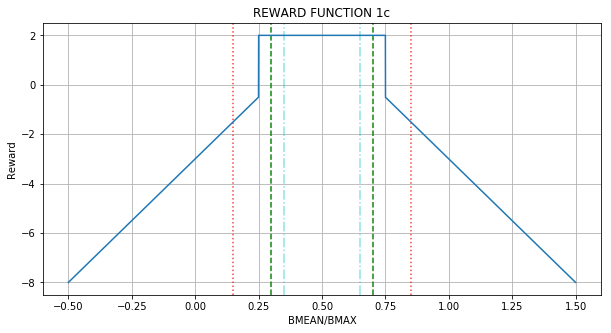

RF_1c(0)            =  -8.00
RF_1c(ENP_MARGIN/4) =  -8.00
RF_1c(ENP_MARGIN/2) =  -8.00
RF_1c(ENP_MARGIN)   =  -8.00

RF_1c(BMAX/2) =  -8.00
RF_1c(BMAX)   =  -8.00



In [15]:
#PLOT REWARD FUNCTIONS
x = np.arange(0-capm.BMAX*0.5,capm.BMAX+capm.BMAX*0.5)
y = [capm.rewardfn() for capm.v_btrack in x]

fig = plt.figure(figsize=(10,5))
ax = fig.add_subplot(111)
ax.set_title('REWARD FUNCTION 1c')
ax.set_xlabel('BMEAN/BMAX')
ax.set_ylabel('Reward')
ax.axvline((capm.ENP_MARGIN)/capm.BMAX, color='g',alpha=0.95, linestyle='--')
ax.axvline((capm.BMAX-capm.ENP_MARGIN)/capm.BMAX, color='g',alpha=0.95, linestyle='--')

ax.axvline((capm.BSAFE_LO)  /capm.BMAX, color='c',alpha=0.45, linestyle='-.')
ax.axvline((capm.BSAFE_HI)  /capm.BMAX, color='c',alpha=0.45, linestyle="-.")
ax.axvline((capm.BLIM_LO)   /capm.BMAX, color='r',alpha=0.75, linestyle=':')
ax.axvline((capm.BLIM_HI)   /capm.BMAX, color='r',alpha=0.75, linestyle=":")
ax.plot(x/capm.BMAX,y)
ax.grid(True)
plt.show()

capm.enp = 0;            print("RF_1c(0)            = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.ENP_MARGIN/4; print("RF_1c(ENP_MARGIN/4) = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.ENP_MARGIN/2; print("RF_1c(ENP_MARGIN/2) = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.ENP_MARGIN;   print("RF_1c(ENP_MARGIN)   = {:6.2f}".format(capm.rewardfn()) )
print("");
capm.enp = capm.BMAX/2; print("RF_1c(BMAX/2) = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.BMAX;   print("RF_1c(BMAX)   = {:6.2f}".format(capm.rewardfn()) )
print("");

In [16]:
#TRAINING STARTS
tic = datetime.now()

Device:  cpu

Iteration 0:  AOMORI, 2003 
EPSILON = 5.000e-01
LR = 3.392e-05
Average Terminal Reward  = -4.030
Day Violations           =    315
Battery Limit Violations =   3452
Action MEAN              =  4.816
Action STD DEV           =  2.004


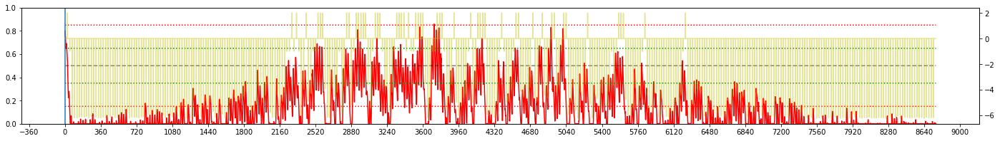


Iteration 1:  AOMORI, 2007 
EPSILON = 5.000e-01
LR = 4.174e-05
Average Terminal Reward  = -3.786
Day Violations           =    303
Battery Limit Violations =   3374
Action MEAN              =  4.945
Action STD DEV           =  2.098


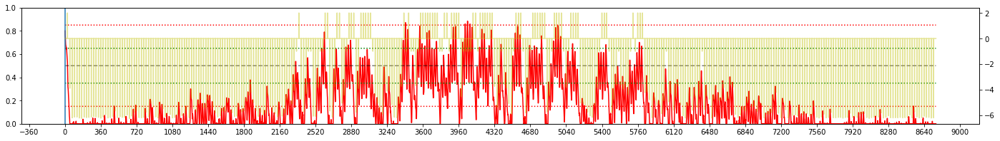


Iteration 2:  AOMORI, 2001 
EPSILON = 5.000e-01
LR = 5.000e-05
Average Terminal Reward  = -3.700
Day Violations           =    299
Battery Limit Violations =   3320
Action MEAN              =  4.896
Action STD DEV           =  2.052


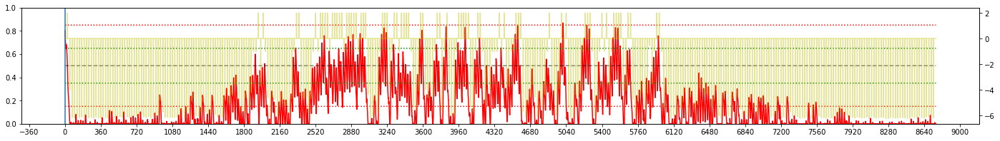


Iteration 3:  AOMORI, 2002 
EPSILON = 5.000e-01
LR = 5.826e-05
Average Terminal Reward  = -3.989
Day Violations           =    314
Battery Limit Violations =   3565
Action MEAN              =  4.841
Action STD DEV           =  2.020


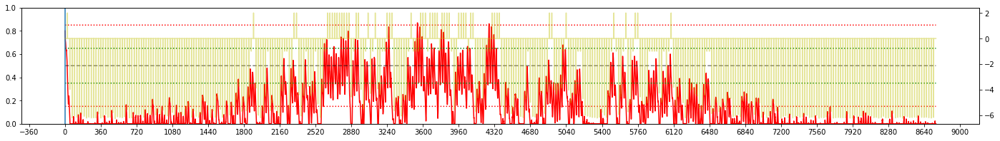


Iteration 4:  AOMORI, 2000 
EPSILON = 5.001e-01
LR = 6.608e-05
Average Terminal Reward  = -3.906
Day Violations           =    307
Battery Limit Violations =   3396
Action MEAN              =  4.852
Action STD DEV           =  2.052


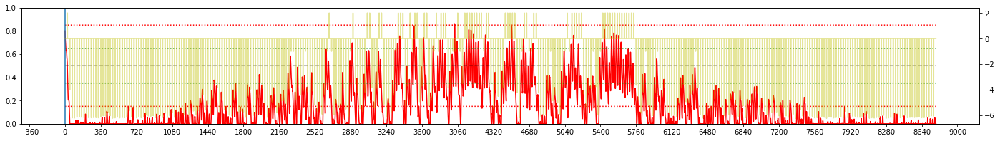


Iteration 5:  AOMORI, 2004 
EPSILON = 5.001e-01
LR = 7.311e-05
Average Terminal Reward  = -3.989
Day Violations           =    314
Battery Limit Violations =   3494
Action MEAN              =  4.858
Action STD DEV           =  1.995


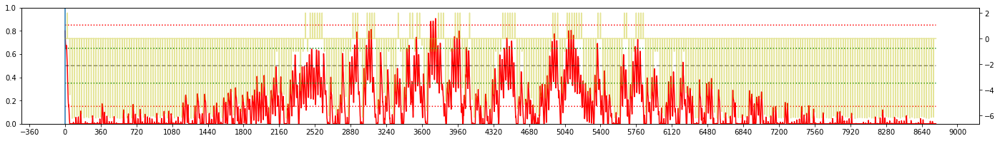


Iteration 6:  AOMORI, 2003 
EPSILON = 5.001e-01
LR = 7.914e-05
Average Terminal Reward  = -4.055
Day Violations           =    315
Battery Limit Violations =   3498
Action MEAN              =  4.862
Action STD DEV           =  1.974


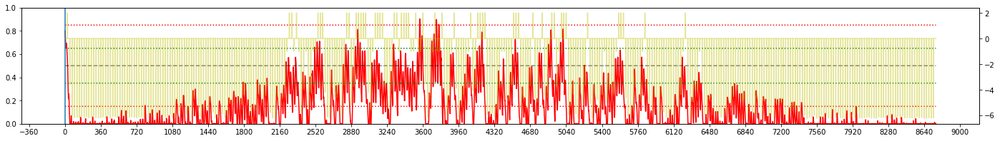


Iteration 7:  AOMORI, 2006 
EPSILON = 5.001e-01
LR = 8.411e-05
Average Terminal Reward  = -3.874
Day Violations           =    307
Battery Limit Violations =   3425
Action MEAN              =  4.804
Action STD DEV           =  2.014


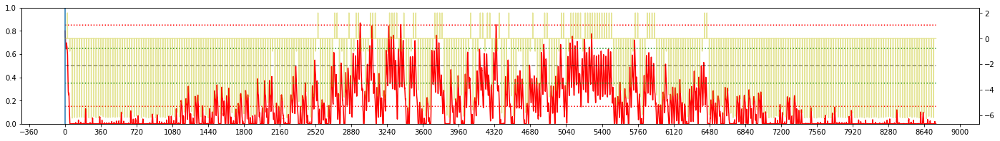


Iteration 8:  AOMORI, 2003 
EPSILON = 5.001e-01
LR = 8.808e-05
Average Terminal Reward  = -4.075
Day Violations           =    317
Battery Limit Violations =   3472
Action MEAN              =  4.820
Action STD DEV           =  1.989


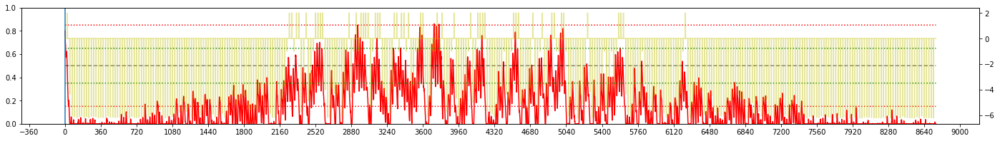


Iteration 9:  AOMORI, 2006 
EPSILON = 5.001e-01
LR = 9.116e-05
Average Terminal Reward  = -4.431
Day Violations           =    325
Battery Limit Violations =   3947
Action MEAN              =  5.551
Action STD DEV           =  2.614


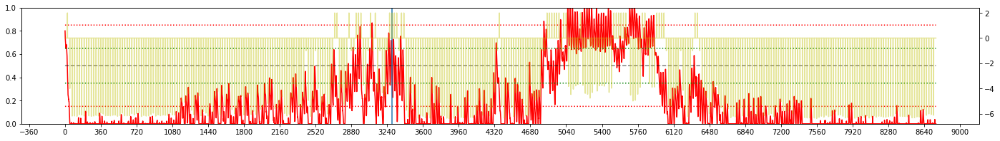


Iteration 10:  AOMORI, 2008 
EPSILON = 5.002e-01
LR = 9.350e-05
Average Terminal Reward  = -3.207
Day Violations           =    277
Battery Limit Violations =   2760
Action MEAN              =  4.724
Action STD DEV           =  2.688


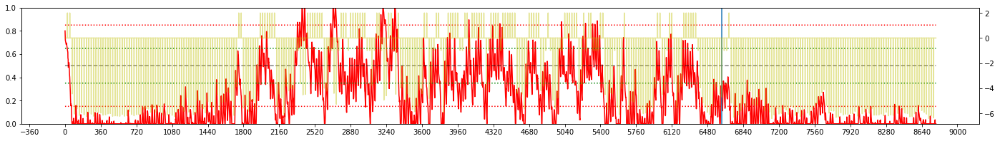


Iteration 11:  AOMORI, 2007 
EPSILON = 5.002e-01
LR = 9.526e-05
Average Terminal Reward  = -3.297
Day Violations           =    286
Battery Limit Violations =   2626
Action MEAN              =  4.488
Action STD DEV           =  2.930


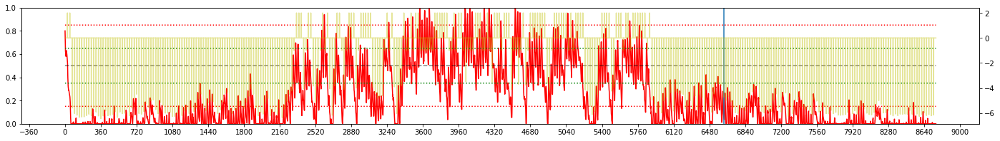


Iteration 12:  AOMORI, 2000 
EPSILON = 5.003e-01
LR = 9.656e-05
Average Terminal Reward  = -3.251
Day Violations           =    278
Battery Limit Violations =   3117
Action MEAN              =  5.176
Action STD DEV           =  3.102


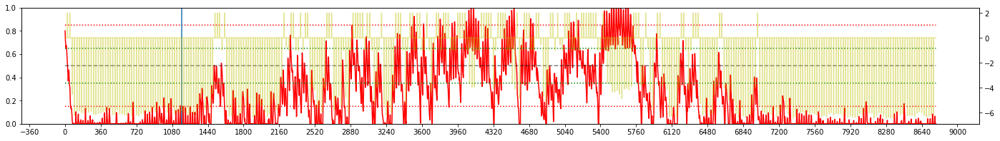


Iteration 13:  AOMORI, 2002 
EPSILON = 5.003e-01
LR = 9.751e-05
Average Terminal Reward  = -2.991
Day Violations           =    267
Battery Limit Violations =   2968
Action MEAN              =  5.189
Action STD DEV           =  3.110


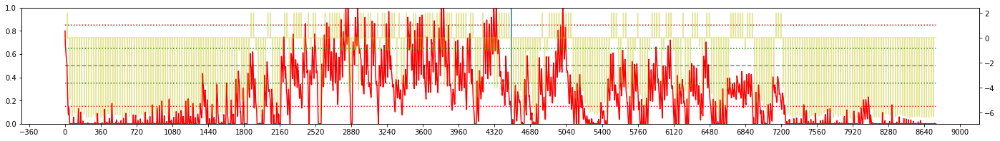


Iteration 14:  AOMORI, 2002 
EPSILON = 5.004e-01
LR = 9.820e-05
Average Terminal Reward  = -1.270
Day Violations           =    164
Battery Limit Violations =   2060
Action MEAN              =  4.328
Action STD DEV           =  2.984


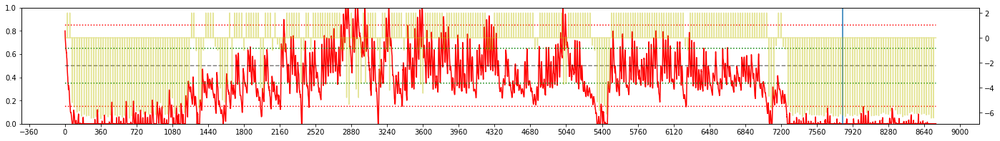


Iteration 15:  AOMORI, 2001 
EPSILON = 5.005e-01
LR = 9.870e-05
Average Terminal Reward  = -0.495
Day Violations           =    128
Battery Limit Violations =   1551
Action MEAN              =  4.075
Action STD DEV           =  2.966


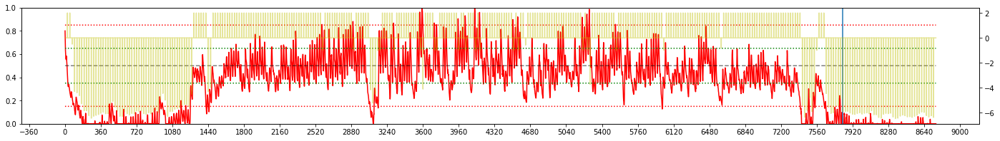


Iteration 16:  AOMORI, 2003 
EPSILON = 5.006e-01
LR = 9.907e-05
Average Terminal Reward  = -0.502
Day Violations           =    123
Battery Limit Violations =   1900
Action MEAN              =  4.253
Action STD DEV           =  3.064


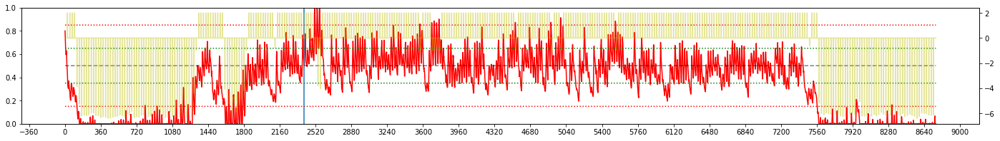


Iteration 17:  AOMORI, 2000 
EPSILON = 5.007e-01
LR = 9.933e-05
Average Terminal Reward  = -0.210
Day Violations           =    110
Battery Limit Violations =   1801
Action MEAN              =  4.321
Action STD DEV           =  3.084


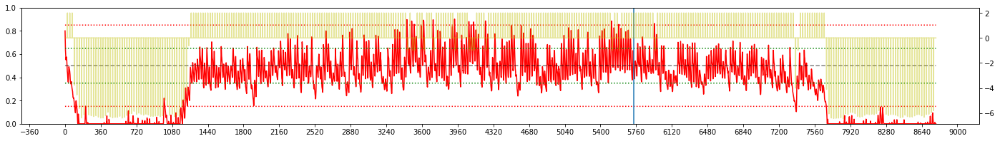


Iteration 18:  AOMORI, 2003 
EPSILON = 5.008e-01
LR = 9.952e-05
Average Terminal Reward  = -0.145
Day Violations           =    104
Battery Limit Violations =   1772
Action MEAN              =  4.291
Action STD DEV           =  3.060


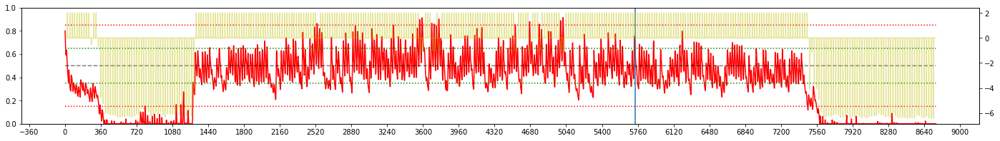


Iteration 19:  AOMORI, 2009 
EPSILON = 5.010e-01
LR = 9.966e-05
Average Terminal Reward  = -0.007
Day Violations           =     95
Battery Limit Violations =   1645
Action MEAN              =  4.226
Action STD DEV           =  2.977


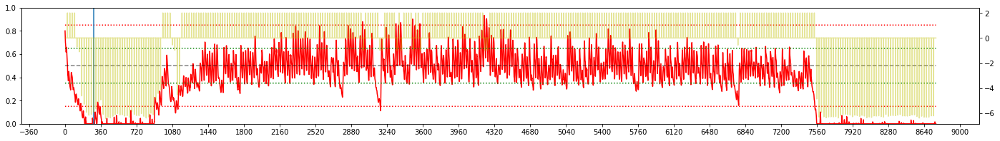


Iteration 20:  AOMORI, 2004 
EPSILON = 5.012e-01
LR = 9.975e-05
Average Terminal Reward  =  0.238
Day Violations           =     85
Battery Limit Violations =   1435
Action MEAN              =  3.984
Action STD DEV           =  3.043


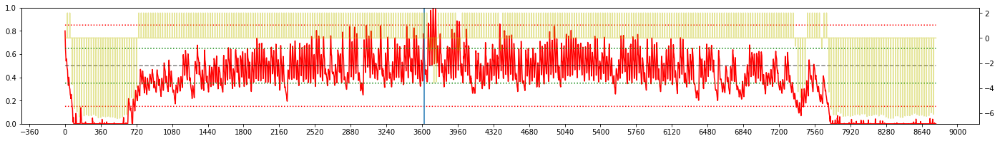


Iteration 21:  AOMORI, 2000 
EPSILON = 5.015e-01
LR = 9.982e-05
Average Terminal Reward  = -0.455
Day Violations           =    118
Battery Limit Violations =   2104
Action MEAN              =  4.404
Action STD DEV           =  3.155


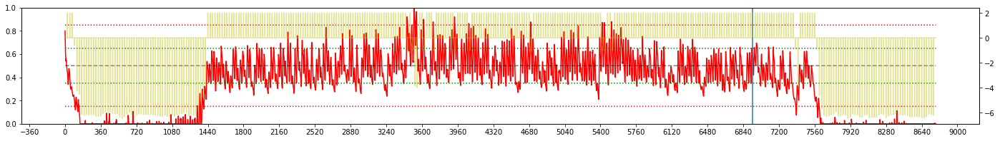


Iteration 22:  AOMORI, 2003 
EPSILON = 5.018e-01
LR = 9.987e-05
Average Terminal Reward  = -0.214
Day Violations           =    106
Battery Limit Violations =   1923
Action MEAN              =  4.518
Action STD DEV           =  3.283


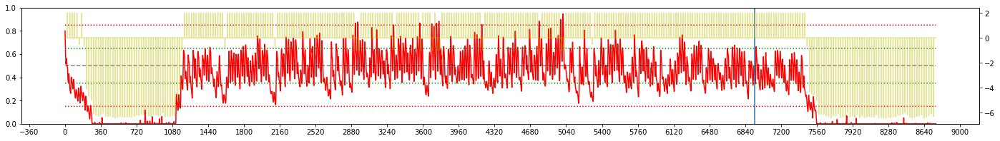


Iteration 23:  AOMORI, 2002 
EPSILON = 5.022e-01
LR = 9.991e-05
Average Terminal Reward  =  0.098
Day Violations           =     95
Battery Limit Violations =   1521
Action MEAN              =  3.921
Action STD DEV           =  3.056


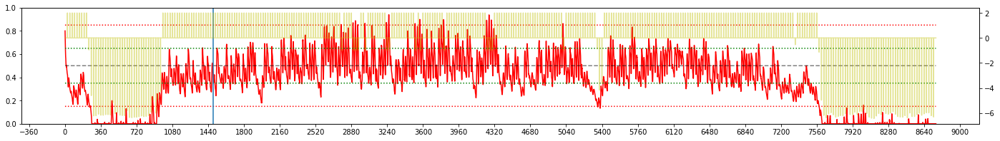


Iteration 24:  AOMORI, 2005 
EPSILON = 5.027e-01
LR = 9.993e-05
Average Terminal Reward  = -0.902
Day Violations           =    140
Battery Limit Violations =   2470
Action MEAN              =  4.550
Action STD DEV           =  3.152


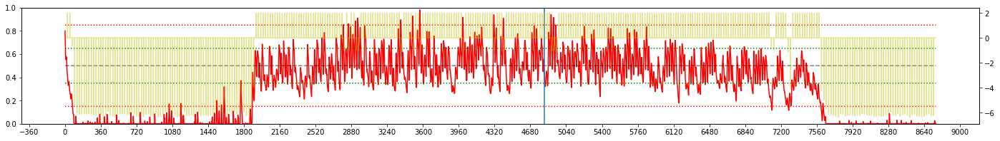


Iteration 25:  AOMORI, 2005 
EPSILON = 5.033e-01
LR = 9.995e-05
Average Terminal Reward  = -0.970
Day Violations           =    142
Battery Limit Violations =   2576
Action MEAN              =  4.666
Action STD DEV           =  3.151


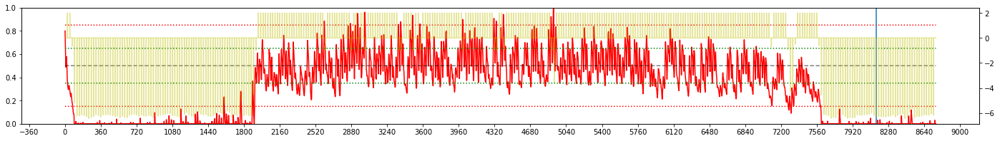


Iteration 26:  AOMORI, 2005 
EPSILON = 5.041e-01
LR = 9.997e-05
Average Terminal Reward  = -0.907
Day Violations           =    141
Battery Limit Violations =   2467
Action MEAN              =  4.605
Action STD DEV           =  3.049


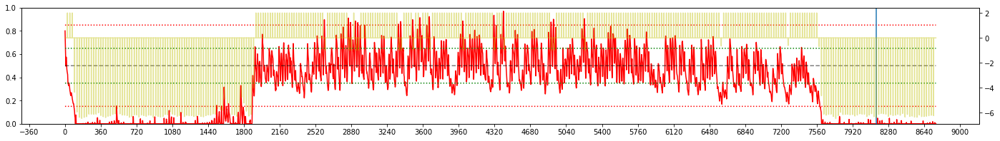


Iteration 27:  AOMORI, 2008 
EPSILON = 5.050e-01
LR = 9.998e-05
Average Terminal Reward  = -0.323
Day Violations           =    123
Battery Limit Violations =   1827
Action MEAN              =  4.305
Action STD DEV           =  3.064


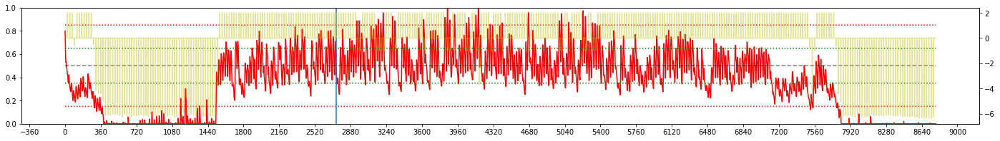


Iteration 28:  AOMORI, 2009 
EPSILON = 5.061e-01
LR = 9.998e-05
Average Terminal Reward  = -0.649
Day Violations           =    134
Battery Limit Violations =   2247
Action MEAN              =  4.370
Action STD DEV           =  3.084


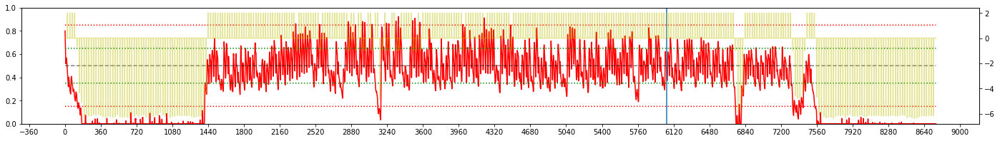


Iteration 29:  AOMORI, 2003 
EPSILON = 5.074e-01
LR = 9.999e-05
Average Terminal Reward  = -0.277
Day Violations           =    112
Battery Limit Violations =   1993
Action MEAN              =  4.105
Action STD DEV           =  3.056


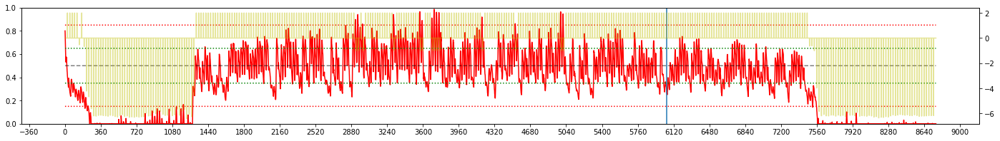


Iteration 30:  AOMORI, 2009 
EPSILON = 5.090e-01
LR = 9.999e-05
Average Terminal Reward  = -0.449
Day Violations           =    120
Battery Limit Violations =   2197
Action MEAN              =  4.388
Action STD DEV           =  3.026


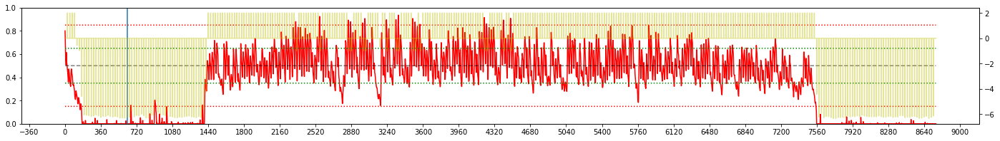


Iteration 31:  AOMORI, 2005 
EPSILON = 5.109e-01
LR = 9.999e-05
Average Terminal Reward  = -0.748
Day Violations           =    138
Battery Limit Violations =   2314
Action MEAN              =  4.524
Action STD DEV           =  3.068


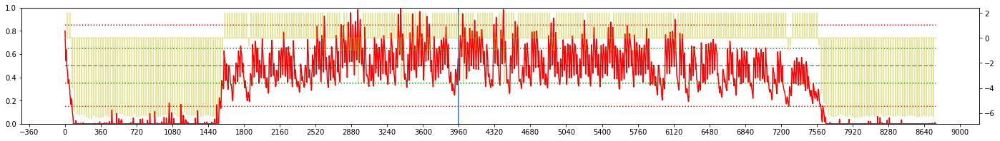


Iteration 32:  AOMORI, 2006 
EPSILON = 5.133e-01
LR = 1.000e-04
Average Terminal Reward  = -0.790
Day Violations           =    135
Battery Limit Violations =   2462
Action MEAN              =  4.656
Action STD DEV           =  3.141


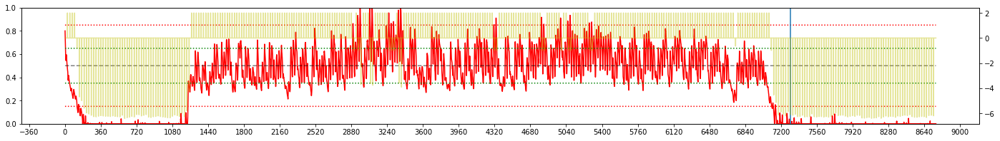


Iteration 33:  AOMORI, 2008 
EPSILON = 5.161e-01
LR = 1.000e-04
Average Terminal Reward  = -0.380
Day Violations           =    127
Battery Limit Violations =   1736
Action MEAN              =  4.334
Action STD DEV           =  3.077


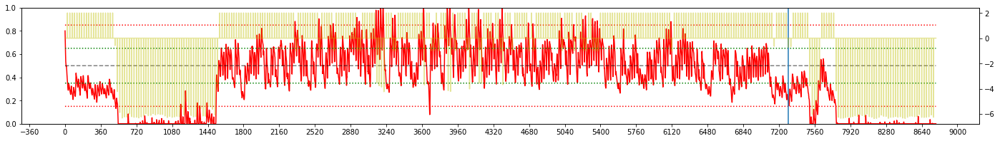


Iteration 34:  AOMORI, 2007 
EPSILON = 5.196e-01
LR = 1.000e-04
Average Terminal Reward  = -0.552
Day Violations           =    140
Battery Limit Violations =   1923
Action MEAN              =  4.354
Action STD DEV           =  3.131


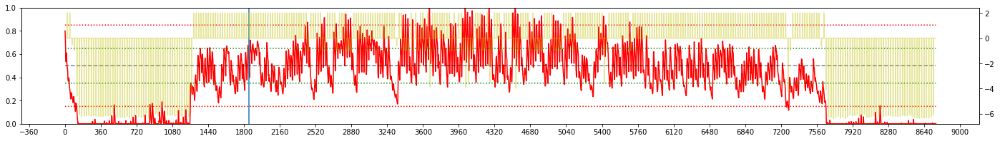


Iteration 35:  AOMORI, 2002 
EPSILON = 5.237e-01
LR = 1.000e-04
Average Terminal Reward  = -0.547
Day Violations           =    129
Battery Limit Violations =   1936
Action MEAN              =  4.156
Action STD DEV           =  3.104


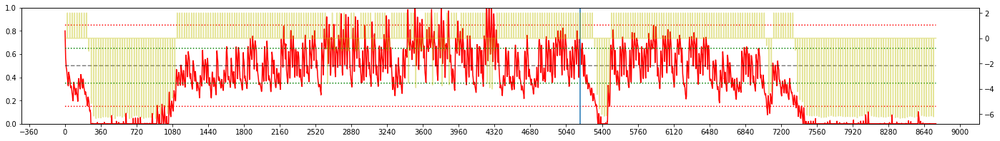


Iteration 36:  AOMORI, 2007 
EPSILON = 5.287e-01
LR = 1.000e-04
Average Terminal Reward  = -0.129
Day Violations           =    121
Battery Limit Violations =   1440
Action MEAN              =  4.163
Action STD DEV           =  3.119


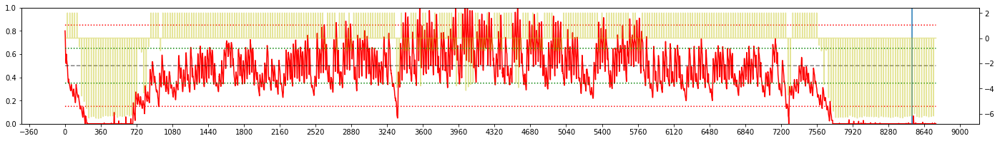


Iteration 37:  AOMORI, 2000 
EPSILON = 5.346e-01
LR = 1.000e-04
Average Terminal Reward  = -0.567
Day Violations           =    135
Battery Limit Violations =   2095
Action MEAN              =  4.386
Action STD DEV           =  3.168


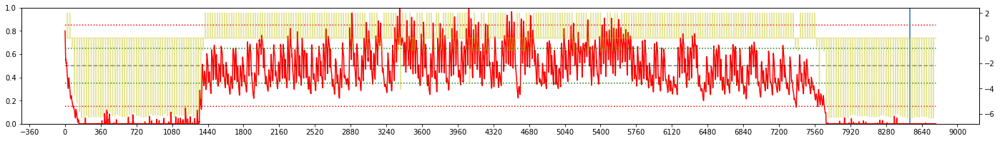


Iteration 38:  AOMORI, 2007 
EPSILON = 5.416e-01
LR = 1.000e-04
Average Terminal Reward  = -0.416
Day Violations           =    135
Battery Limit Violations =   1811
Action MEAN              =  4.411
Action STD DEV           =  3.186


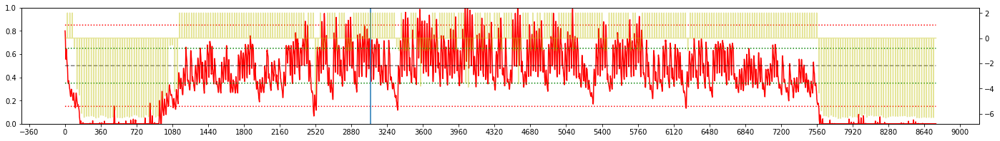


Iteration 39:  AOMORI, 2009 
EPSILON = 5.499e-01
LR = 1.000e-04
Average Terminal Reward  = -0.521
Day Violations           =    128
Battery Limit Violations =   2199
Action MEAN              =  4.230
Action STD DEV           =  3.167


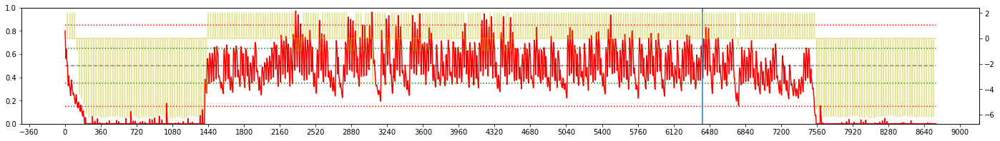


Iteration 40:  AOMORI, 2005 
EPSILON = 5.596e-01
LR = 1.000e-04
Average Terminal Reward  = -0.828
Day Violations           =    146
Battery Limit Violations =   2260
Action MEAN              =  4.167
Action STD DEV           =  3.137


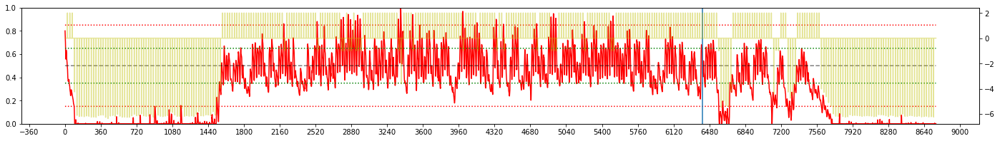


Iteration 41:  AOMORI, 2008 
EPSILON = 5.709e-01
LR = 1.000e-04
Average Terminal Reward  = -0.679
Day Violations           =    143
Battery Limit Violations =   2003
Action MEAN              =  4.280
Action STD DEV           =  3.152


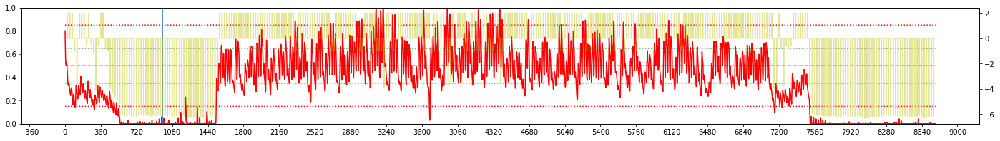


Iteration 42:  AOMORI, 2003 
EPSILON = 5.840e-01
LR = 1.000e-04
Average Terminal Reward  = -0.391
Day Violations           =    122
Battery Limit Violations =   2034
Action MEAN              =  4.136
Action STD DEV           =  3.208


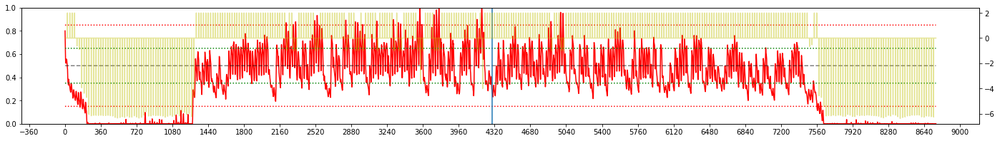


Iteration 43:  AOMORI, 2005 
EPSILON = 5.989e-01
LR = 1.000e-04
Average Terminal Reward  = -0.743
Day Violations           =    136
Battery Limit Violations =   2431
Action MEAN              =  4.387
Action STD DEV           =  3.249


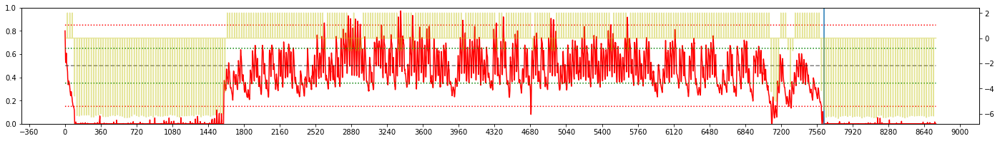


Iteration 44:  AOMORI, 2008 
EPSILON = 6.157e-01
LR = 1.000e-04
Average Terminal Reward  = -0.086
Day Violations           =    106
Battery Limit Violations =   1693
Action MEAN              =  4.342
Action STD DEV           =  3.224


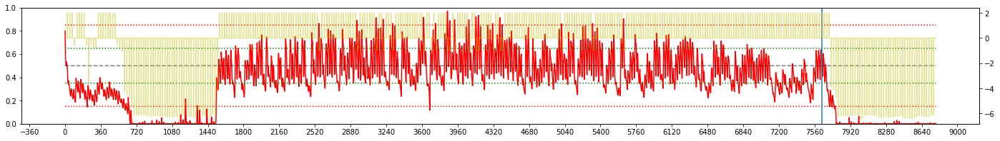


Iteration 45:  AOMORI, 2000 
EPSILON = 6.345e-01
LR = 1.000e-04
Average Terminal Reward  = -0.516
Day Violations           =    126
Battery Limit Violations =   2219
Action MEAN              =  4.600
Action STD DEV           =  3.150


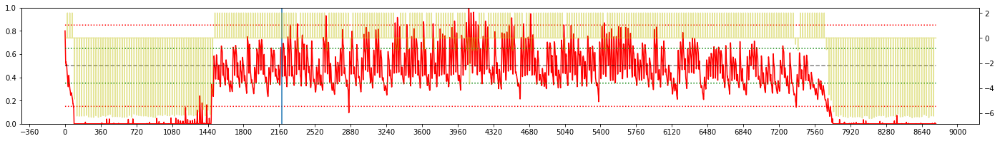


Iteration 46:  AOMORI, 2001 
EPSILON = 6.550e-01
LR = 1.000e-04
Average Terminal Reward  = -0.774
Day Violations           =    145
Battery Limit Violations =   2409
Action MEAN              =  4.679
Action STD DEV           =  2.991


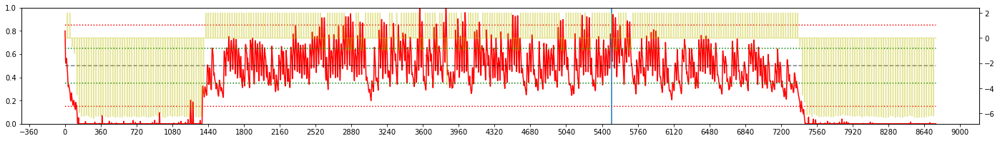


Iteration 47:  AOMORI, 2007 
EPSILON = 6.772e-01
LR = 1.000e-04
Average Terminal Reward  = -0.387
Day Violations           =    125
Battery Limit Violations =   2017
Action MEAN              =  4.456
Action STD DEV           =  3.035


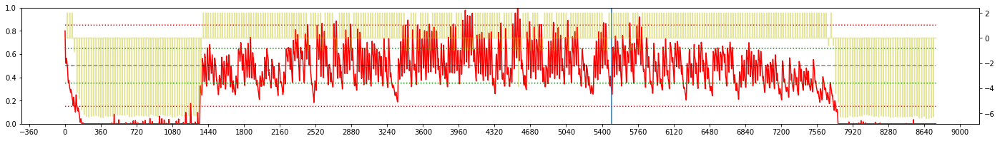


Iteration 48:  AOMORI, 2006 
EPSILON = 7.007e-01
LR = 1.000e-04
Average Terminal Reward  = -0.563
Day Violations           =    137
Battery Limit Violations =   2139
Action MEAN              =  4.394
Action STD DEV           =  3.023


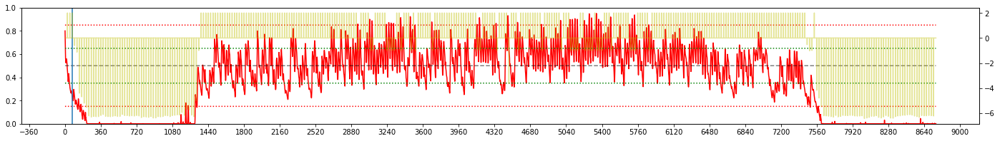


Iteration 49:  AOMORI, 2009 
EPSILON = 7.251e-01
LR = 1.000e-04
Average Terminal Reward  = -0.589
Day Violations           =    134
Battery Limit Violations =   2270
Action MEAN              =  4.380
Action STD DEV           =  3.046


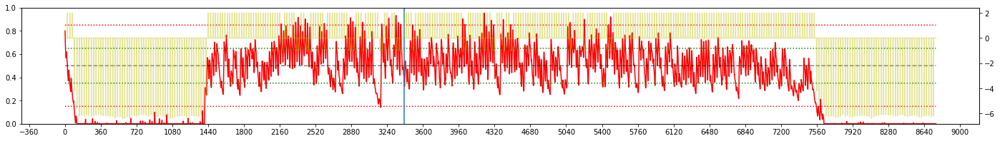


Iteration 50:  AOMORI, 2007 
EPSILON = 7.500e-01
LR = 1.000e-04
Average Terminal Reward  = -0.333
Day Violations           =    121
Battery Limit Violations =   1863
Action MEAN              =  4.373
Action STD DEV           =  3.199


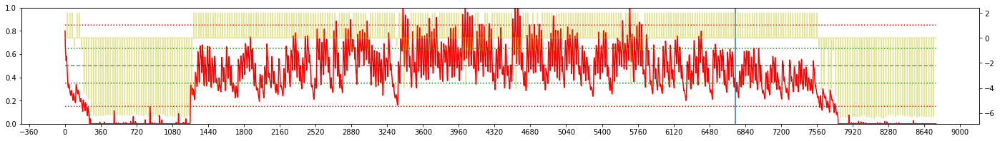


Iteration 51:  AOMORI, 2008 
EPSILON = 7.749e-01
LR = 8.750e-05
Average Terminal Reward  =  0.375
Day Violations           =     83
Battery Limit Violations =   1231
Action MEAN              =  4.139
Action STD DEV           =  3.345


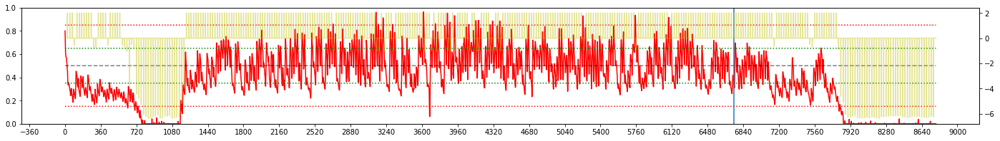


Iteration 52:  AOMORI, 2001 
EPSILON = 7.993e-01
LR = 7.681e-05
Average Terminal Reward  = -0.372
Day Violations           =    119
Battery Limit Violations =   2094
Action MEAN              =  4.376
Action STD DEV           =  3.416


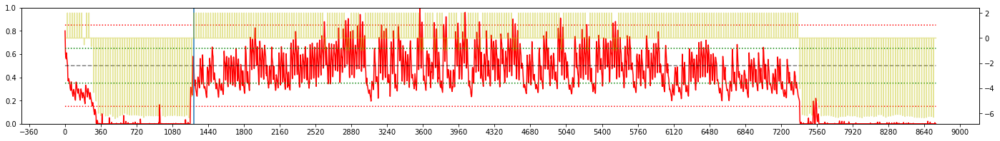


Iteration 53:  AOMORI, 2001 
EPSILON = 8.228e-01
LR = 6.767e-05
Average Terminal Reward  = -0.408
Day Violations           =    116
Battery Limit Violations =   2110
Action MEAN              =  4.475
Action STD DEV           =  3.396


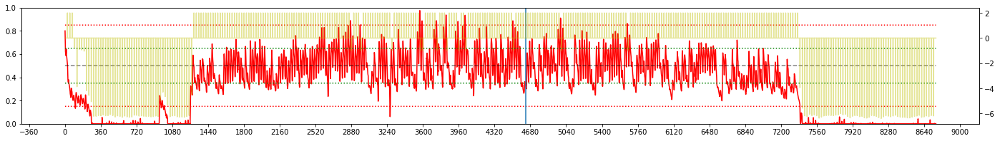


Iteration 54:  AOMORI, 2002 
EPSILON = 8.450e-01
LR = 5.986e-05
Average Terminal Reward  = -0.389
Day Violations           =    113
Battery Limit Violations =   2097
Action MEAN              =  4.305
Action STD DEV           =  3.398


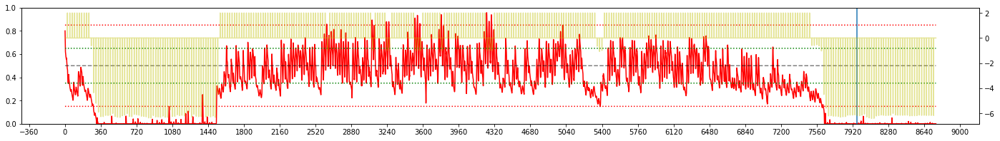


Iteration 55:  AOMORI, 2004 
EPSILON = 8.655e-01
LR = 5.318e-05
Average Terminal Reward  = -0.148
Day Violations           =    100
Battery Limit Violations =   1961
Action MEAN              =  4.276
Action STD DEV           =  3.313


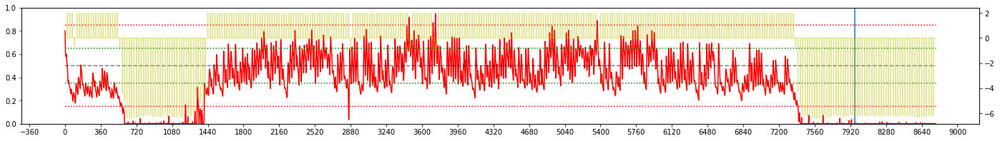


Iteration 56:  AOMORI, 2007 
EPSILON = 8.843e-01
LR = 4.747e-05
Average Terminal Reward  = -0.071
Day Violations           =     95
Battery Limit Violations =   1905
Action MEAN              =  4.514
Action STD DEV           =  3.344


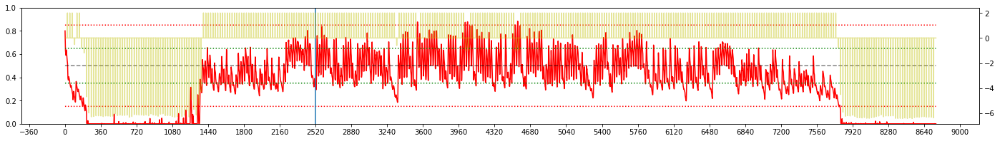


Iteration 57:  AOMORI, 2008 
EPSILON = 9.011e-01
LR = 4.259e-05
Average Terminal Reward  =  1.053
Day Violations           =     43
Battery Limit Violations =    890
Action MEAN              =  3.840
Action STD DEV           =  3.021


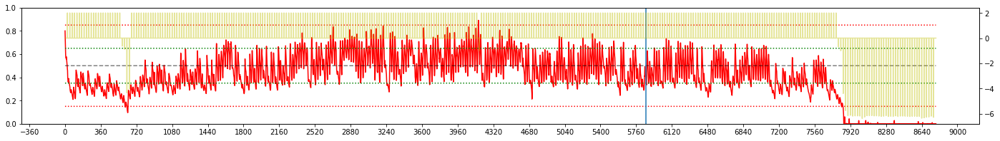


Iteration 58:  AOMORI, 2006 
EPSILON = 9.160e-01
LR = 3.841e-05
Average Terminal Reward  =  0.887
Day Violations           =     49
Battery Limit Violations =   1119
Action MEAN              =  3.745
Action STD DEV           =  2.947


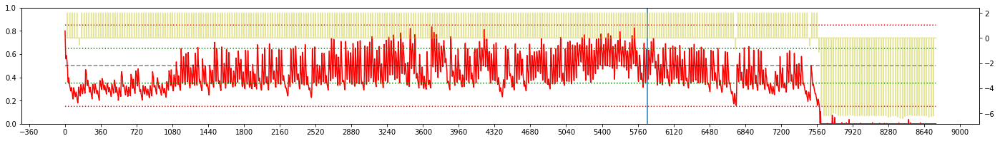


Iteration 59:  AOMORI, 2006 
EPSILON = 9.291e-01
LR = 3.484e-05
Average Terminal Reward  = -0.155
Day Violations           =     96
Battery Limit Violations =   2123
Action MEAN              =  4.163
Action STD DEV           =  3.002


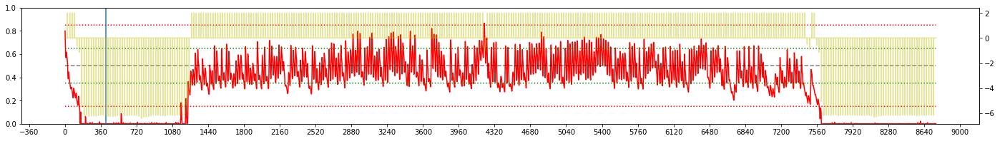


Iteration 60:  AOMORI, 2005 
EPSILON = 9.404e-01
LR = 3.179e-05
Average Terminal Reward  = -0.358
Day Violations           =    106
Battery Limit Violations =   2282
Action MEAN              =  4.173
Action STD DEV           =  3.084


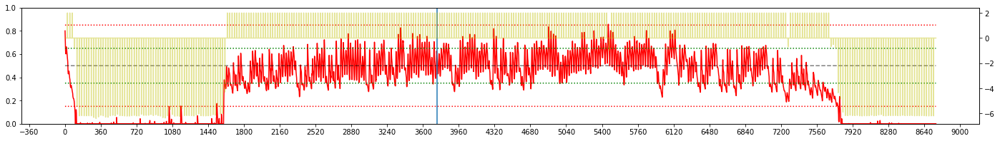


Iteration 61:  AOMORI, 2009 
EPSILON = 9.501e-01
LR = 2.918e-05
Average Terminal Reward  = -0.311
Day Violations           =    108
Battery Limit Violations =   2138
Action MEAN              =  4.207
Action STD DEV           =  3.037


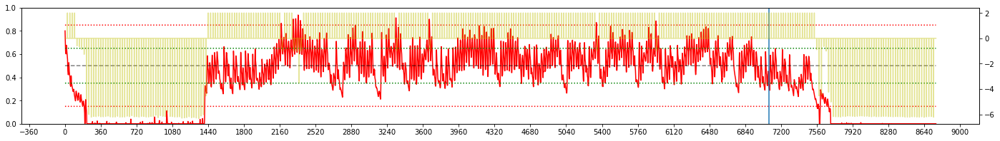


Iteration 62:  AOMORI, 2006 
EPSILON = 9.584e-01
LR = 2.695e-05
Average Terminal Reward  =  1.284
Day Violations           =     34
Battery Limit Violations =    542
Action MEAN              =  3.398
Action STD DEV           =  2.965


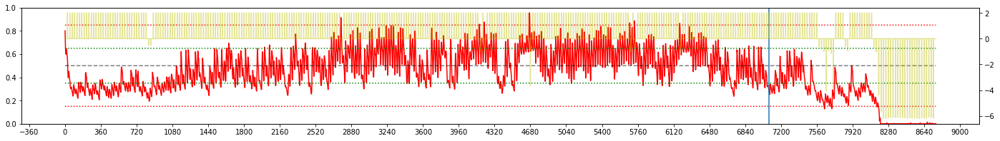


Iteration 63:  AOMORI, 2003 
EPSILON = 9.654e-01
LR = 2.504e-05
Average Terminal Reward  =  1.334
Day Violations           =     35
Battery Limit Violations =    543
Action MEAN              =  3.479
Action STD DEV           =  2.893


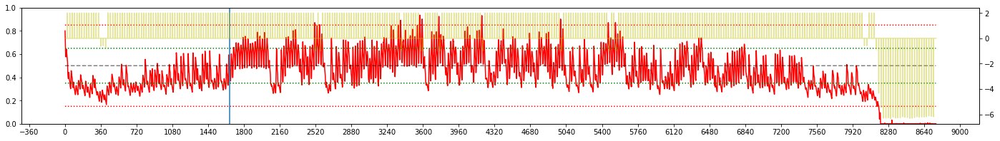


Iteration 64:  AOMORI, 2004 
EPSILON = 9.713e-01
LR = 2.341e-05
Average Terminal Reward  =  1.103
Day Violations           =     43
Battery Limit Violations =    685
Action MEAN              =  3.606
Action STD DEV           =  2.967


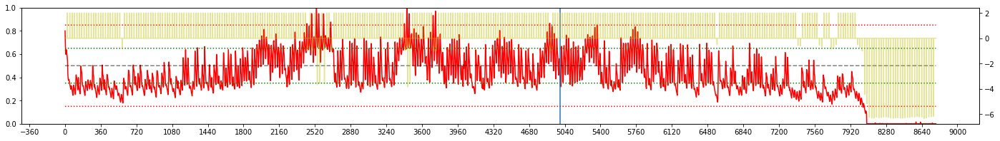


Iteration 65:  AOMORI, 2001 
EPSILON = 9.763e-01
LR = 2.202e-05
Average Terminal Reward  =  0.652
Day Violations           =     65
Battery Limit Violations =   1269
Action MEAN              =  3.750
Action STD DEV           =  2.950


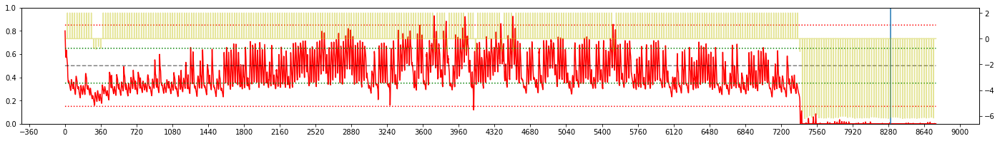


Iteration 66:  AOMORI, 2000 
EPSILON = 9.804e-01
LR = 2.082e-05
Average Terminal Reward  =  0.315
Day Violations           =     76
Battery Limit Violations =   1510
Action MEAN              =  4.055
Action STD DEV           =  3.074


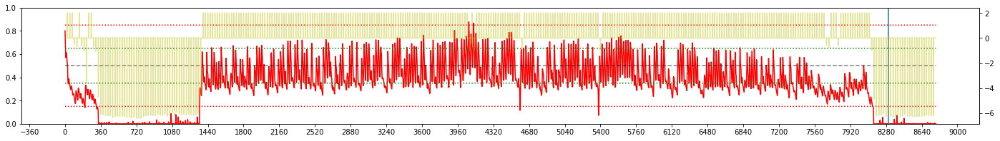


Iteration 67:  AOMORI, 2003 
EPSILON = 9.839e-01
LR = 1.980e-05
Average Terminal Reward  =  1.415
Day Violations           =     24
Battery Limit Violations =    521
Action MEAN              =  3.372
Action STD DEV           =  2.806


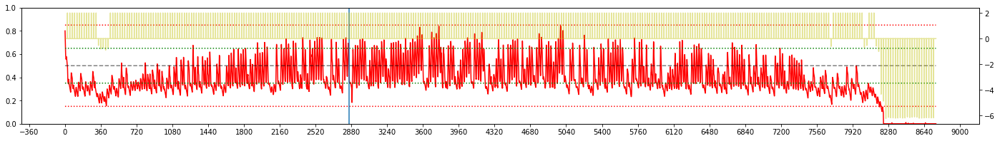


Iteration 68:  AOMORI, 2003 
EPSILON = 9.867e-01
LR = 1.893e-05
Average Terminal Reward  =  0.664
Day Violations           =     60
Battery Limit Violations =   1236
Action MEAN              =  3.646
Action STD DEV           =  2.965


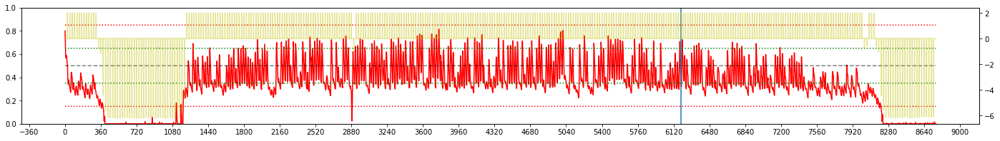


Iteration 69:  AOMORI, 2000 
EPSILON = 9.891e-01
LR = 1.819e-05
Average Terminal Reward  =  0.252
Day Violations           =     79
Battery Limit Violations =   1698
Action MEAN              =  3.831
Action STD DEV           =  3.087


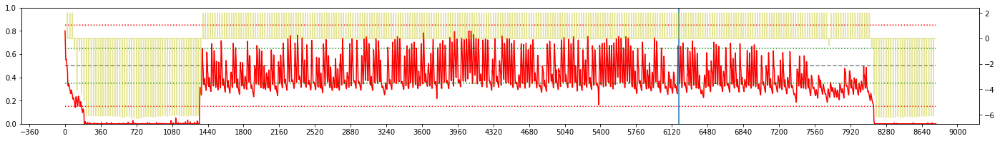


Iteration 70:  AOMORI, 2009 
EPSILON = 9.910e-01
LR = 1.755e-05
Average Terminal Reward  =  0.847
Day Violations           =     51
Battery Limit Violations =   1123
Action MEAN              =  3.655
Action STD DEV           =  3.081


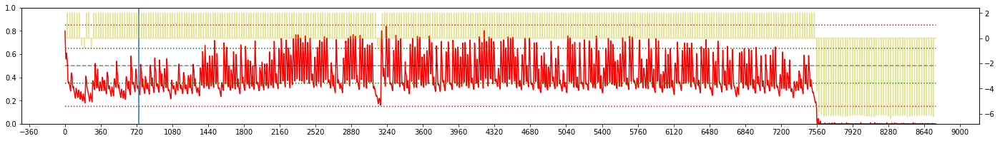


Iteration 71:  AOMORI, 2007 
EPSILON = 9.926e-01
LR = 1.701e-05
Average Terminal Reward  =  1.024
Day Violations           =     48
Battery Limit Violations =    895
Action MEAN              =  3.816
Action STD DEV           =  3.119


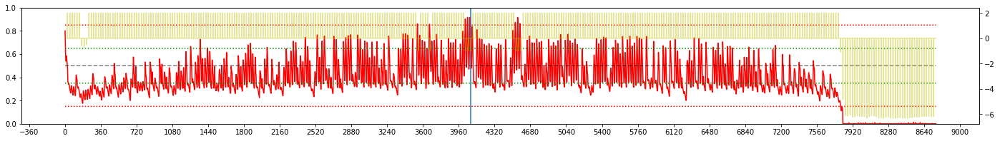


Iteration 72:  AOMORI, 2004 
EPSILON = 9.939e-01
LR = 1.654e-05
Average Terminal Reward  =  1.259
Day Violations           =     32
Battery Limit Violations =    677
Action MEAN              =  3.463
Action STD DEV           =  2.986


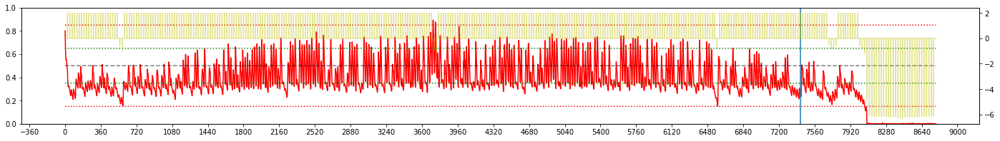


Iteration 73:  AOMORI, 2003 
EPSILON = 9.950e-01
LR = 1.614e-05
Average Terminal Reward  =  1.384
Day Violations           =     27
Battery Limit Violations =    523
Action MEAN              =  3.376
Action STD DEV           =  3.066


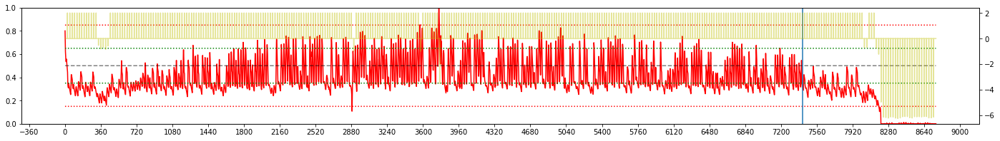


Iteration 74:  AOMORI, 2005 
EPSILON = 9.959e-01
LR = 1.580e-05
Average Terminal Reward  =  0.504
Day Violations           =     68
Battery Limit Violations =   1337
Action MEAN              =  3.875
Action STD DEV           =  3.194


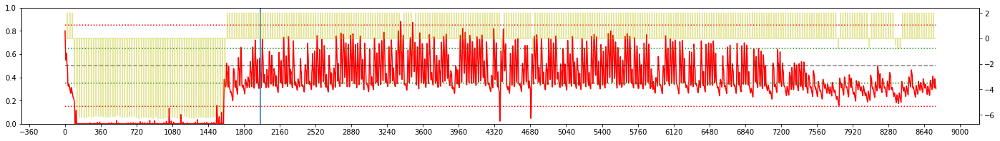


Iteration 75:  AOMORI, 2000 
EPSILON = 9.967e-01
LR = 1.551e-05
Average Terminal Reward  =  0.177
Day Violations           =     84
Battery Limit Violations =   1759
Action MEAN              =  4.096
Action STD DEV           =  3.221


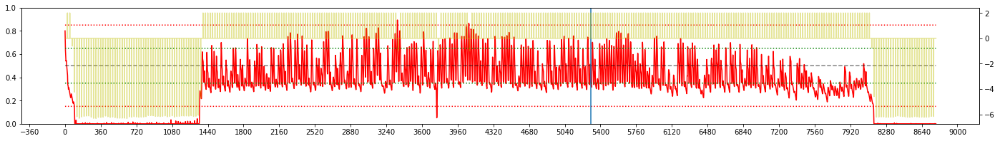


Iteration 76:  AOMORI, 2006 
EPSILON = 9.973e-01
LR = 1.526e-05
Average Terminal Reward  =  0.886
Day Violations           =     50
Battery Limit Violations =   1095
Action MEAN              =  3.503
Action STD DEV           =  3.244


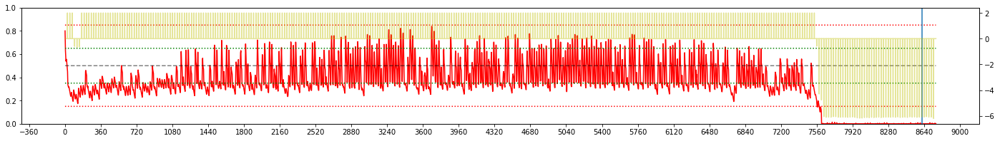


Iteration 77:  AOMORI, 2001 
EPSILON = 9.978e-01
LR = 1.505e-05
Average Terminal Reward  =  1.359
Day Violations           =     28
Battery Limit Violations =    519
Action MEAN              =  3.508
Action STD DEV           =  3.255


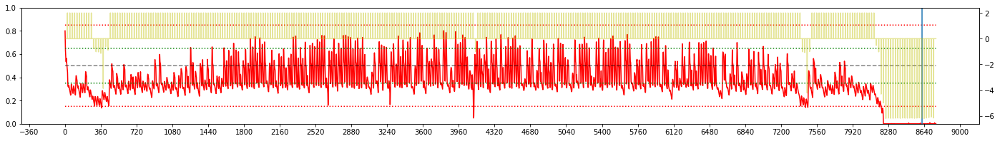


Iteration 78:  AOMORI, 2007 
EPSILON = 9.982e-01
LR = 1.487e-05
Average Terminal Reward  =  1.065
Day Violations           =     42
Battery Limit Violations =    907
Action MEAN              =  3.799
Action STD DEV           =  3.332


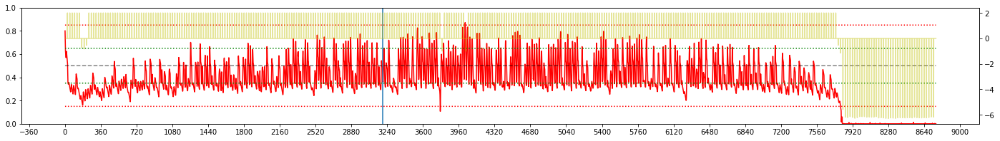


Iteration 79:  AOMORI, 2004 
EPSILON = 9.985e-01
LR = 1.471e-05
Average Terminal Reward  =  1.302
Day Violations           =     30
Battery Limit Violations =    657
Action MEAN              =  3.455
Action STD DEV           =  3.269


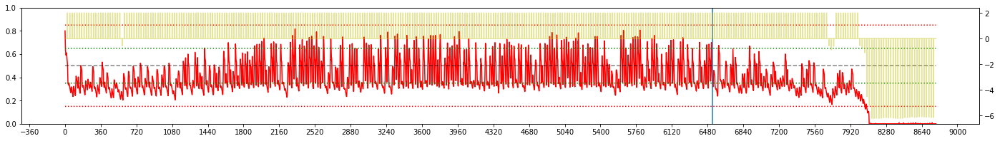


Iteration 80:  AOMORI, 2005 
EPSILON = 9.988e-01
LR = 1.458e-05
Average Terminal Reward  =  0.579
Day Violations           =     62
Battery Limit Violations =   1220
Action MEAN              =  3.663
Action STD DEV           =  3.415


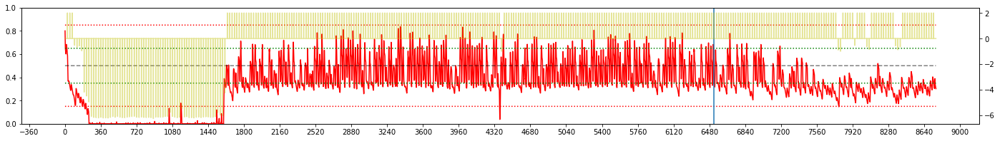


Iteration 81:  AOMORI, 2005 
EPSILON = 9.990e-01
LR = 1.446e-05
Average Terminal Reward  =  0.529
Day Violations           =     64
Battery Limit Violations =   1351
Action MEAN              =  3.868
Action STD DEV           =  3.531


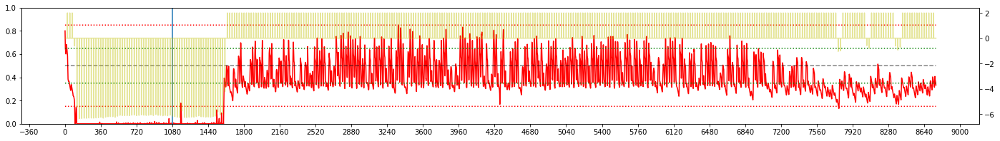


Iteration 82:  AOMORI, 2001 
EPSILON = 9.992e-01
LR = 1.437e-05
Average Terminal Reward  =  1.372
Day Violations           =     27
Battery Limit Violations =    484
Action MEAN              =  3.738
Action STD DEV           =  3.502


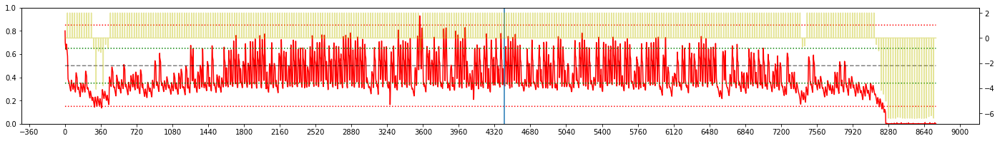


Iteration 83:  AOMORI, 2006 
EPSILON = 9.993e-01
LR = 1.428e-05
Average Terminal Reward  =  0.892
Day Violations           =     49
Battery Limit Violations =   1094
Action MEAN              =  3.789
Action STD DEV           =  3.353


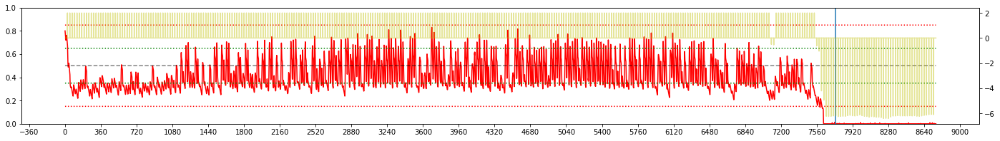


Iteration 84:  AOMORI, 2009 
EPSILON = 9.994e-01
LR = 1.421e-05
Average Terminal Reward  =  0.821
Day Violations           =     51
Battery Limit Violations =   1138
Action MEAN              =  3.859
Action STD DEV           =  3.412


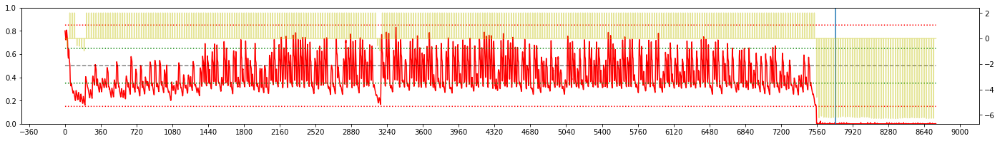


Iteration 85:  AOMORI, 2003 
EPSILON = 9.995e-01
LR = 1.415e-05
Average Terminal Reward  =  1.431
Day Violations           =     23
Battery Limit Violations =    490
Action MEAN              =  3.430
Action STD DEV           =  3.141


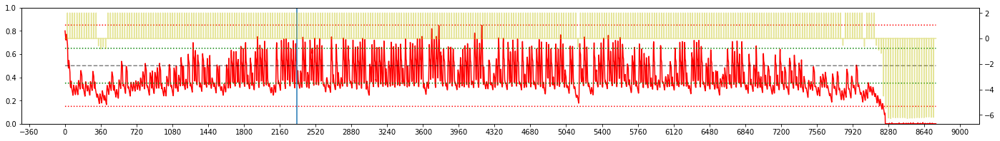


Iteration 86:  AOMORI, 2003 
EPSILON = 9.996e-01
LR = 1.410e-05
Average Terminal Reward  =  1.415
Day Violations           =     24
Battery Limit Violations =    492
Action MEAN              =  3.391
Action STD DEV           =  3.114


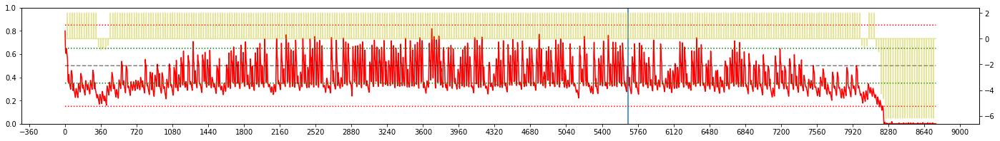


Iteration 87:  AOMORI, 2000 
EPSILON = 9.997e-01
LR = 1.406e-05
Average Terminal Reward  =  0.237
Day Violations           =     80
Battery Limit Violations =   1693
Action MEAN              =  3.996
Action STD DEV           =  3.278


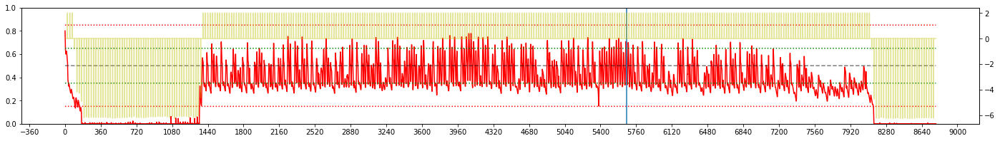


Iteration 88:  AOMORI, 2005 
EPSILON = 9.997e-01
LR = 1.402e-05
Average Terminal Reward  =  0.188
Day Violations           =     82
Battery Limit Violations =   1616
Action MEAN              =  4.001
Action STD DEV           =  3.182


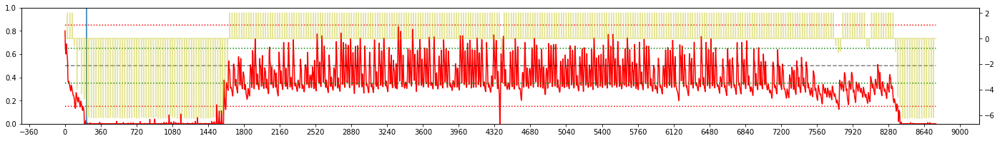


Iteration 89:  AOMORI, 2009 
EPSILON = 9.998e-01
LR = 1.398e-05
Average Terminal Reward  = -0.307
Day Violations           =    104
Battery Limit Violations =   2207
Action MEAN              =  4.509
Action STD DEV           =  3.258


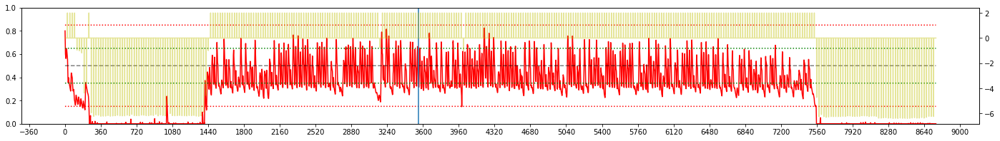


Iteration 90:  AOMORI, 2007 
EPSILON = 9.998e-01
LR = 1.396e-05
Average Terminal Reward  =  1.054
Day Violations           =     41
Battery Limit Violations =    903
Action MEAN              =  3.765
Action STD DEV           =  3.143


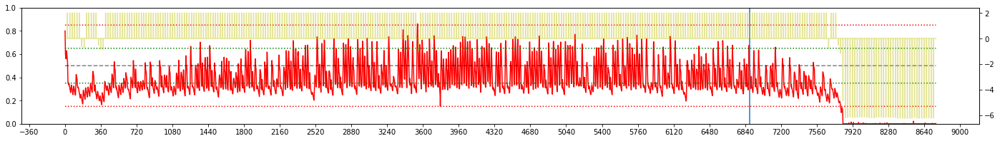


Iteration 91:  AOMORI, 2005 
EPSILON = 9.999e-01
LR = 1.393e-05
Average Terminal Reward  =  0.483
Day Violations           =     67
Battery Limit Violations =   1375
Action MEAN              =  3.899
Action STD DEV           =  3.231


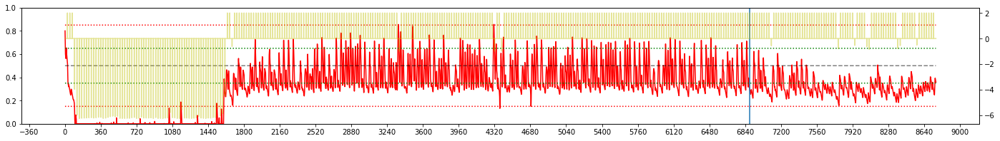


Iteration 92:  AOMORI, 2004 
EPSILON = 9.999e-01
LR = 1.391e-05
Average Terminal Reward  =  1.256
Day Violations           =     31
Battery Limit Violations =    644
Action MEAN              =  3.560
Action STD DEV           =  3.186


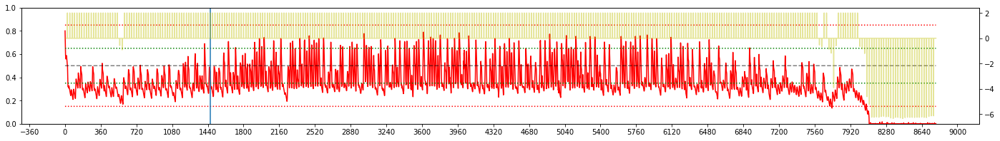


Iteration 93:  AOMORI, 2001 
EPSILON = 9.999e-01
LR = 1.390e-05
Average Terminal Reward  = -0.219
Day Violations           =    101
Battery Limit Violations =   2085
Action MEAN              =  4.263
Action STD DEV           =  3.284


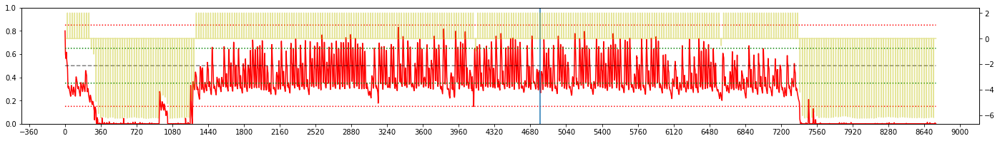


Iteration 94:  AOMORI, 2000 
EPSILON = 9.999e-01
LR = 1.388e-05
Average Terminal Reward  =  0.118
Day Violations           =     85
Battery Limit Violations =   1735
Action MEAN              =  3.869
Action STD DEV           =  3.298


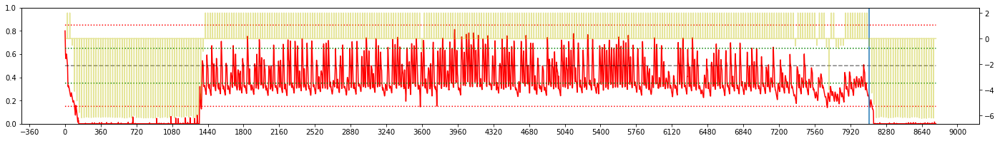


Iteration 95:  AOMORI, 2008 
EPSILON = 9.999e-01
LR = 1.387e-05
Average Terminal Reward  =  1.397
Day Violations           =     27
Battery Limit Violations =    516
Action MEAN              =  3.684
Action STD DEV           =  3.332


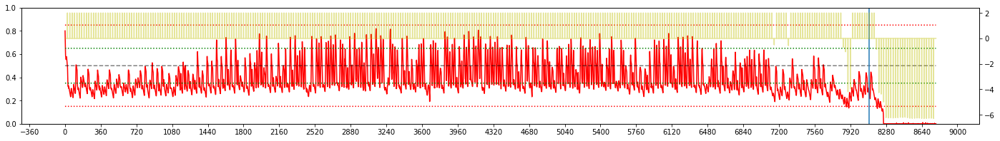


Iteration 96:  AOMORI, 2005 
EPSILON = 9.999e-01
LR = 1.386e-05
Average Terminal Reward  =  0.469
Day Violations           =     67
Battery Limit Violations =   1344
Action MEAN              =  3.921
Action STD DEV           =  3.291


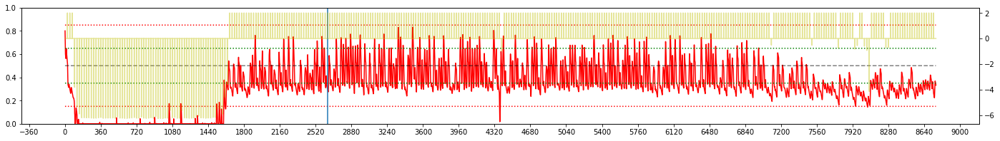


Iteration 97:  AOMORI, 2006 
EPSILON = 1.000e+00
LR = 1.385e-05
Average Terminal Reward  =  0.840
Day Violations           =     51
Battery Limit Violations =   1165
Action MEAN              =  3.788
Action STD DEV           =  3.191


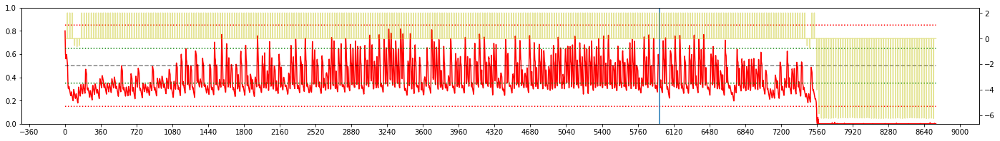


Iteration 98:  AOMORI, 2002 
EPSILON = 1.000e+00
LR = 1.384e-05
Average Terminal Reward  = -0.252
Day Violations           =    103
Battery Limit Violations =   2054
Action MEAN              =  4.097
Action STD DEV           =  3.162


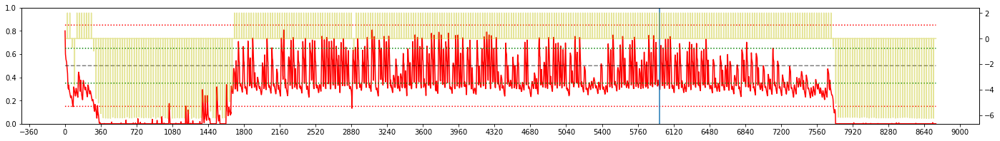


Iteration 99:  AOMORI, 2000 
EPSILON = 1.000e+00
LR = 1.383e-05
Average Terminal Reward  =  0.159
Day Violations           =     82
Battery Limit Violations =   1793
Action MEAN              =  4.175
Action STD DEV           =  3.206


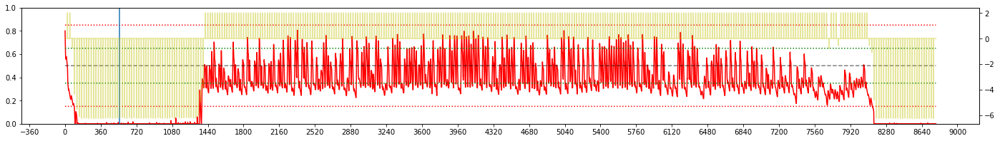

In [17]:
#TRAIN 
dqn = DQN()
# for recording weights
oldfc1 = dqn.eval_net.fc1.weight.data.cpu().numpy().flatten()
old2fc1 = oldfc1

# oldfc2 = dqn.eval_net.fc2.weight.data.cpu().numpy().flatten()
# old2fc2 = oldfc2

# oldfc3 = dqn.eval_net.fc3.weight.data.cpu().numpy().flatten()
# old2fc3 = oldfc3

oldout = dqn.eval_net.fc_out.weight.data.cpu().numpy().flatten()
old2out = oldout
########################################

change_hr = 0 #when dqn target_net is updated by eval_net
avg_reward_rec = [] #record the yearly average rewards over the entire duration of training
batt_violation_rec = []
day_violation_rec = []

print('Device: ', dqn.device)
#TRAINING STARTS
tic = datetime.now()

e_rec = []
lr_rec = []
for iteration in range(NO_OF_ITERATIONS):
    # EPSILON SCHEDULING
    e_slope = 5
    e_start = 0.5
    e_inflection_point = 50
    EPSILON = e_start + (1-e_start)/(1 + np.exp(-(iteration-e_inflection_point)/e_slope))

    # LR SCEHDULING
    lr_slope = 3
    lr_start = 0
    lr_inflection_point = 2
    if iteration <=50:
        lrate =  (lr_start + (1-lr_start)/(1 + np.exp(-(iteration-lr_inflection_point)/lr_slope)))*1e-4
    else:
        lrate = 0.95*(lrate-lrate*0.1)+0.2*1e-5
    dqn.optimizer = torch.optim.Adam(dqn.eval_net.parameters(), lr=lrate)
#     dqn.optimizer = torch.optim.Adam(dqn.eval_net.parameters(), lr=lrate, weight_decay=WT_DECAY))
    lr_rec= np.append(lr_rec,lrate)

    LOCATION    = 'aomori'#random.choice(['tokyo','wakkanai','minamidaito'])
    YEAR        = random.choice(np.arange(2000,2010))
    
    capm        = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
    capm.eno    = ENO(LOCATION,YEAR, shuffle=False, day_balance=False) #instantiate the environment inside the CAPM class
    capm.HMAX   = capm.eno.SMAX #maximum power output of solar cell is set in CAPM object using the value in ENO object


    s, r, day_end, year_end = capm.reset(batt=0.8*capm.BMAX)
    yr_record      = np.empty(4)
    transition_rec = np.zeros((capm.eno.TIME_STEPS, N_STATES * 2 + 2)) #record all the transition in one day

    while True:
        a = dqn.choose_action(stdize(s))
        yr_record = np.vstack((yr_record, [s[0],s[2],r, a]))

        # take action
        s_, r, day_end, year_end = capm.step(a)
        
        temp_transitions                = np.hstack((stdize(s), [a, r], stdize(s_)))
        transition_rec[capm.eno.hr-1,:] = temp_transitions

        if (day_end):
            transition_rec[:,5]  = r #broadcast reward to all states
            decay_factor         = [i for i in (LAMBDA**n for n in reversed(range(0, capm.eno.TIME_STEPS)))]
            transition_rec[:,5]  = transition_rec[:,5] * decay_factor #decay reward proportionately
            dqn.store_day_transition(transition_rec)

        if dqn.good_memory_counter > MEMORY_CAPACITY and dqn.bad_memory_counter > MEMORY_CAPACITY:
            dqn.learn()

        if dqn.nettoggle:
            change_hr = capm.eno.day*24+capm.eno.hr #to mark when the DQN is updated.
            dqn.nettoggle = not dqn.nettoggle

        if (year_end):
            break

        # transition to new state
        s = s_

    yr_record = np.delete(yr_record, 0, 0)     #remove the first row which is garbage
    hourly_yr_reward_rec = yr_record[:,2]      #extract reward information from the record array
    yr_reward_rec = hourly_yr_reward_rec[::24] #only consider terminal rewards

    print('\nIteration {}:  {}, {} '.format(iteration, LOCATION.upper(), YEAR))
    print('EPSILON = {:6.3e}'.format(EPSILON))
    for param_group in dqn.optimizer.param_groups:
        print('LR = {:6.3e}'.format(param_group['lr']))
    print("Average Terminal Reward  = {:6.3f}".format(np.mean(yr_reward_rec)))
    print("Day Violations           = {:6d}".format(capm.violation_counter))
    print("Battery Limit Violations = {:6d}".format(capm.batt_violations))
    print("Action MEAN              = {:6.3f}".format(np.mean(yr_record[:,-1] + 1)))
    print("Action STD DEV           = {:6.3f}".format(np.std(yr_record[:,-1] + 1)))
   
    # Log the average reward in avg_reward_rec to plot later in the learning curve graph figure
    avg_reward_rec      = np.append(avg_reward_rec, np.mean(yr_reward_rec))
    day_violation_rec   = np.append(day_violation_rec, capm.violation_counter)
    batt_violation_rec  = np.append(batt_violation_rec, capm.batt_violations)

###########################################################################################
###########################################################################################
#   PLOT battery levels, hourly rewards and the weights
    
    #PLOT BATTERY AND REWARD
    fig = plt.figure(figsize=(24,3))
    TIME_STEPS = capm.eno.TIME_STEPS
    NO_OF_DAYS = capm.eno.NO_OF_DAYS
    DAY_SPACING = 15
    TICK_SPACING = TIME_STEPS*DAY_SPACING
    
    #plot battery
    ax = fig.add_subplot(111)
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS),  yr_record[:,0],'r')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*capm.BOPT/capm.BMAX, 'k--', alpha=0.5)
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*capm.BLIM_LO/capm.BMAX, 'r:')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*capm.BLIM_HI/capm.BMAX, 'r:')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:')
    ax.set_ylim([0,1])
    ax.axvline(x=change_hr)
    ax.xaxis.set_major_locator(ticker.MultipleLocator(TICK_SPACING))

    #plot hourly reward
    ax0 = ax.twinx()
    ax0.plot(hourly_yr_reward_rec, color='y',alpha=0.4)
#     ax0.set_ylim(-4,2)
    
    plt.show()
# # #################################################################
#     # PLOT WEIGHTS
#     fig = plt.figure(figsize=(18,6))

#     ax1 = fig.add_subplot(211)
#     newfc1 = dqn.eval_net.fc1.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newfc1.shape[0])
#     ax1.bar(xaxis, old2fc1, color='b', alpha = 0.3)
#     ax1.bar(xaxis, oldfc1,  color='b', alpha = 0.5)
#     ax1.bar(xaxis, newfc1,  color='b', alpha = 1.0)
#     ax1.set_title("FC1")
# #     ax1.set_ylim([-4,4])
#     ax1.set_ylabel("Weight Value")

#     axO = fig.add_subplot(212)
#     newout = dqn.eval_net.fc_out.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newout.shape[0])
#     axO.bar(xaxis, old2out, color='g', alpha = 0.3)
#     axO.bar(xaxis, oldout,  color='g', alpha = 0.5)
#     axO.bar(xaxis, newout,  color='g', alpha = 1.0)
#     axO.set_title("FC OUT")
# #     axO.set_ylim([-4,4])
#     axO.set_ylabel("Weight Value")

#     fig.tight_layout()
#     plt.show()
# # #################################################################

#     # PLOT HISTOGRAM OF WEIGHTS
#     fig = plt.figure(figsize=(18,6))

#     ax1 = fig.add_subplot(211)
#     newfc1 = dqn.eval_net.fc1.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newfc1.shape[0])
# #     ax1.hist(old2fc1, density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='b' , alpha = 0.1 )
# #     ax1.hist(oldfc1,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='b' , alpha = 0.3 )
#     ax1.hist(newfc1,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='b' , alpha = 0.6 )
#     ax1.set_title("FC1")
#     ax1.set_xlabel("Weight Value")


#     axO = fig.add_subplot(212)
#     newout = dqn.eval_net.fc_out.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newout.shape[0])
# #     axO.hist(old2out, density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='g' , alpha = 0.1)
# #     axO.hist(oldout,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='g' , alpha = 0.3)
#     axO.hist(newout,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='g' , alpha = 0.6)
#     axO.set_title("FC OUT")
#     axO.set_xlabel("Weight Value")


#     fig.tight_layout()
#     plt.show()
# # #################################################################    
    
#     old2fc1 = oldfc1
#     oldfc1 = newfc1
    
#     old2out = oldout
#     oldout = newout

    # End of training

In [18]:
print('Train time: {}\n'.format(datetime.now() - tic))
torch.save(dqn.eval_net.state_dict(), './models/'+ 'demo_' + MODELNAME)

Train time: 0:23:48.483508



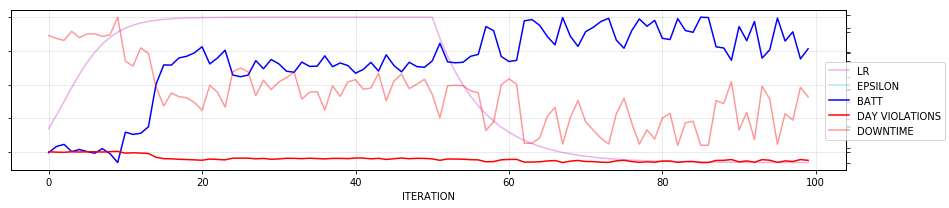

In [19]:
###########################################################################################
###########################################################################################

#PLOT LR AND EPSILON SCHEDULING
fig = plt.figure(figsize=(12,3))
ax = fig.add_subplot(111)
# ax.set_title("LR and EPSILON SCHEDULING V3")
ax.set_xlabel("ITERATION")
# ax.set_ylabel("LR",      color = 'm')
ax.plot(lr_rec,          color = 'm', alpha = 0.3,label="LR")
# ax.tick_params(axis='y', color = 'm')
# ax.ticklabel_format(style='sci', axis='y', scilimits=(-6,-7))
# ax.minorticks_on()

# ax.set_axisbelow(True)
ax.yaxis.set_ticklabels([])

ax.grid(b=True, which='minor', linestyle=':',  color='k', alpha = 0.1)
ax.grid(b=True, which='major', linestyle='-',  color='k', alpha = 0.1)

ax_ = ax.twinx()
# ax_.set_ylabel("EPSILON", color = 'c')
# ax_.tick_params(axis='y', color = 'c')
# ax_.set_axisbelow(True)
# ax_.minorticks_on()
ax_.plot(e_rec,           color = 'c', alpha = 0.3, label="EPSILON")
ax_.yaxis.set_ticklabels([])

# Plot the average reward log
ax1 = ax.twinx()
# ax1.set_ylabel("Terminal Reward", color = 'b')
# ax1.set_ylim([-10,2]);
ax1.plot(avg_reward_rec,'b',label="BATT")
# ax1.tick_params(axis='y', colors='b')
ax1.yaxis.set_ticklabels([])

# Plot the violation record log
ax2 = ax.twinx()
# ax2.set_ylabel("Violations",color = 'r')
ax2.plot(day_violation_rec,'r', label="DAY VIOLATIONS")
ax2.plot(batt_violation_rec,'r',alpha=0.4, label="DOWNTIME")
for xpt in np.argwhere(batt_violation_rec<1):
    ax2.axvline(x=xpt,color='g',linewidth='0.5')
# ax2.set_ylim([0,50]);
# ax2.tick_params(axis='y', colors='r')
ax2.yaxis.set_ticklabels([])

fig.legend(bbox_to_anchor=(1.1, 0.7))


fig.tight_layout()

###########################################################################################
###########################################################################################

In [20]:
# print("ITERATION #0 :  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[0],e_rec[0]))
# print("ITERATION #10:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[10],e_rec[10]))
# print("ITERATION #20:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[20],e_rec[20]))
# print("ITERATION #50:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[50],e_rec[50]))
# print("ITERATION #80:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[80],e_rec[80]))
# print("ITERATION #99:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[99],e_rec[99]))

In [21]:
S_FILENAME = './models/'+ 'demo_'+ MODELNAME
# S_FILENAME = './models/'+ MODELNAME
print("Loading MODEL from FILE: ", S_FILENAME)
dqn = DQN()
dqn.eval_net.load_state_dict(torch.load(S_FILENAME))
dqn.eval_net.eval()
print("DEVICE: ", dqn.device)

Loading MODEL from FILE:  ./models/demo_G_aomori_314.pt
DEVICE:  cpu


***MEASURING PERFORMANCE OF THE MODEL***


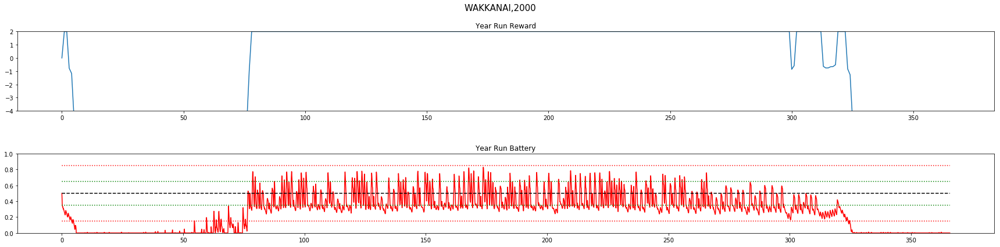

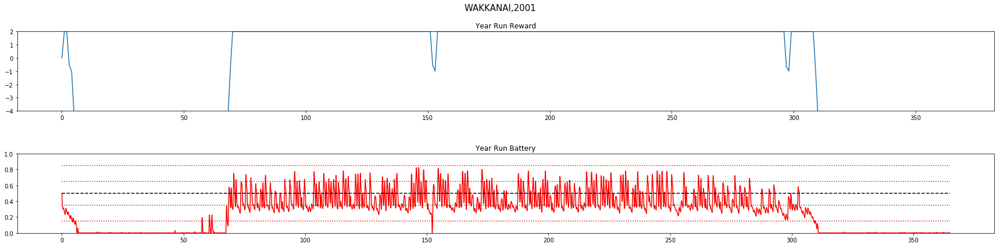

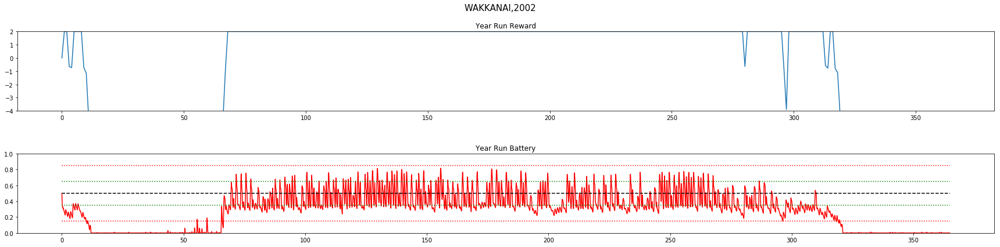

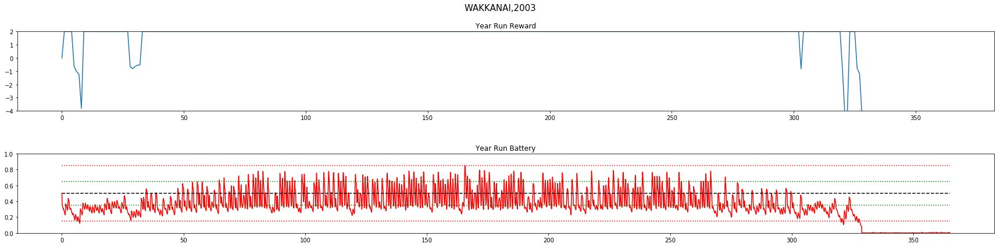

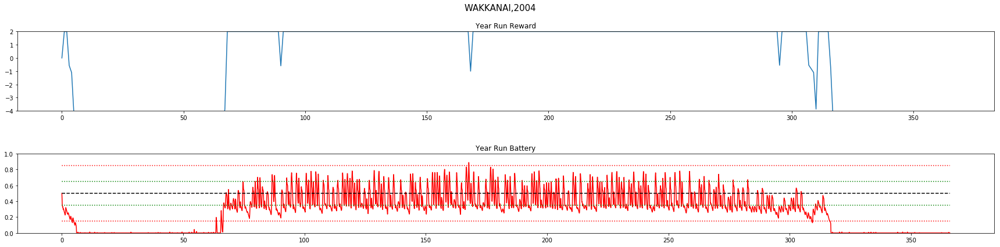

...

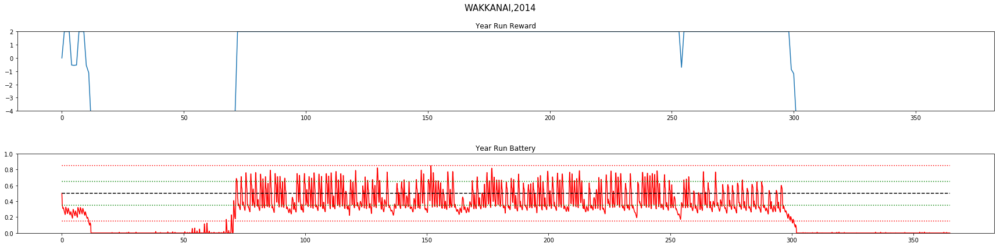

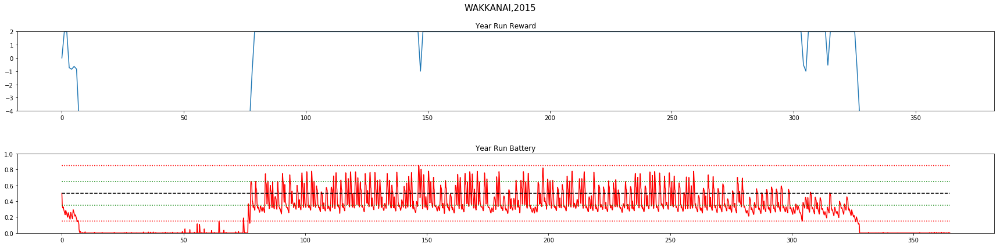

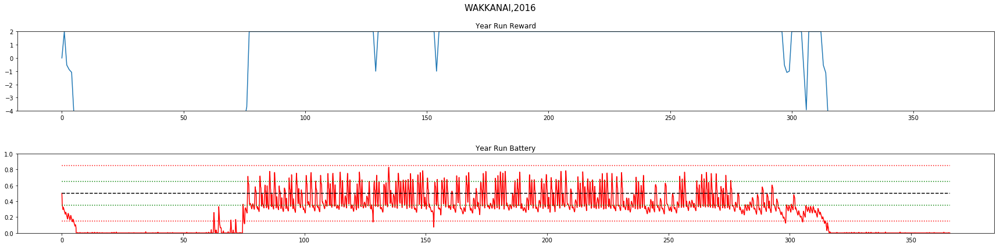

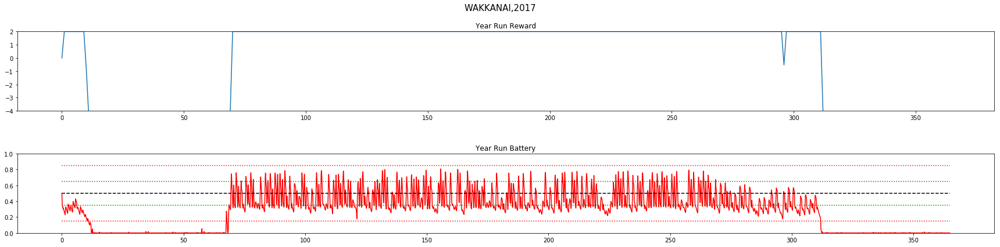

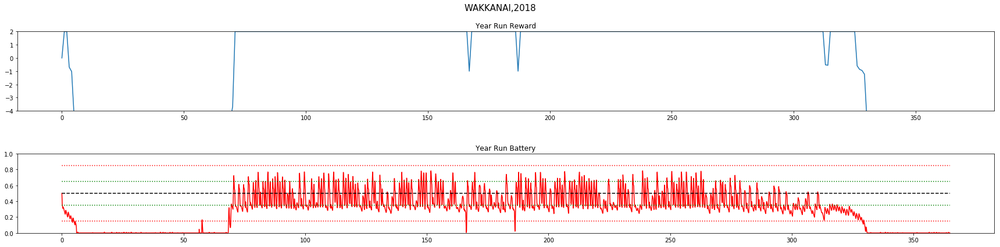



WAKKANAI
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 -0.59		115	 2292
2001	 -0.72		122	 2634
2002	 -0.38		105	 2212
2003	 1.02		41	 846
2004	 -0.58		115	 2517
2005	 -1.15		142	 3177
2006	 0.82		51	 1105
2007	 -0.49		112	 2387
2008	 -0.4		107	 2223
2009	 -0.53		112	 2459
2010	 -0.99		134	 2991
2011	 -0.74		123	 2653
2012	 -0.8		125	 2707
2013	 -0.75		124	 2676
2014	 -0.84		125	 2761
2015	 -0.52		113	 2390
2016	 -0.84		128	 2658
2017	 -0.52		113	 2508
2018	 -0.33		104	 2229

TOTAL Day Violations:   2111.0
TOTAL Batt Violations:  45425.0
************************************


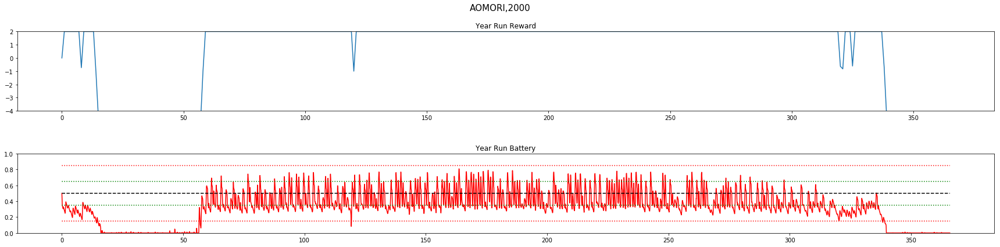

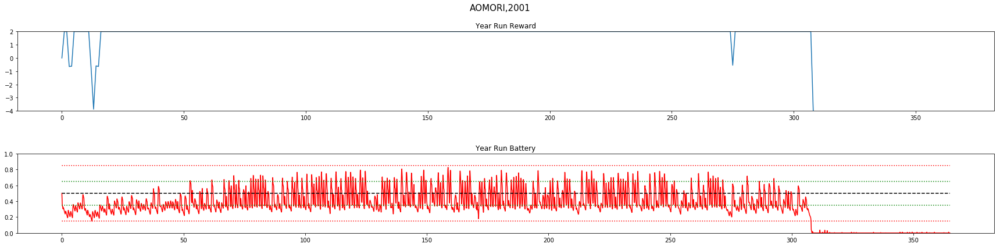

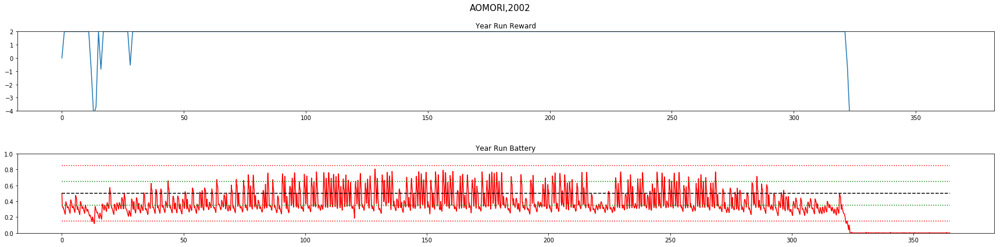

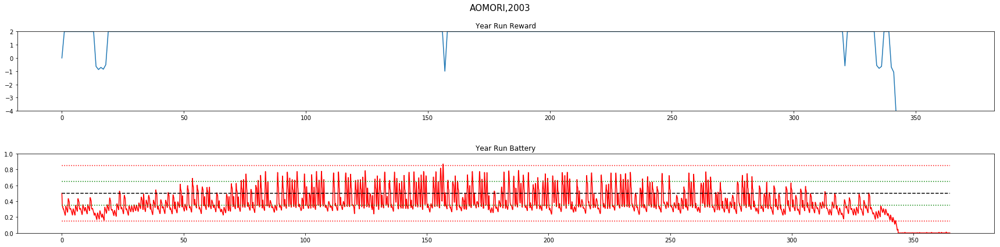

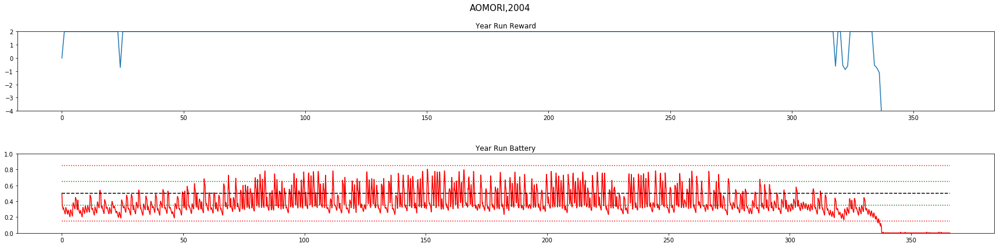

...

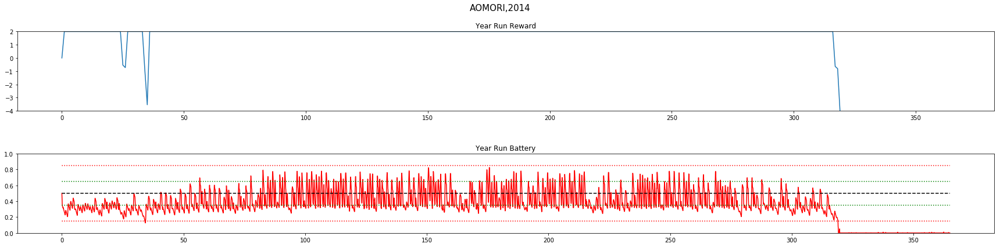

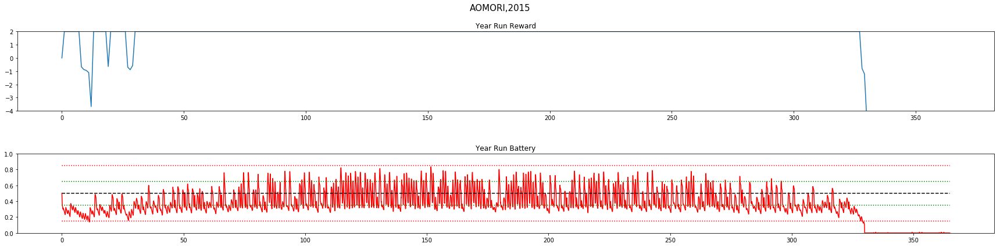

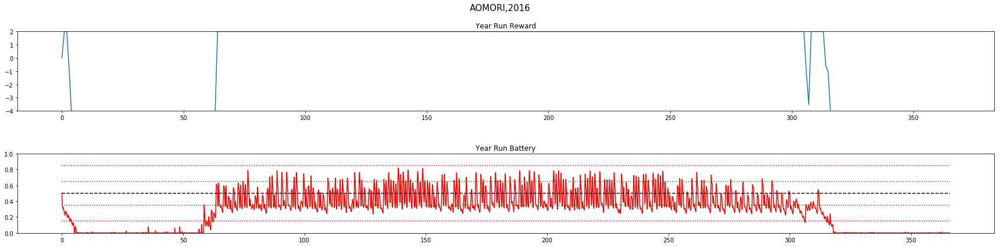

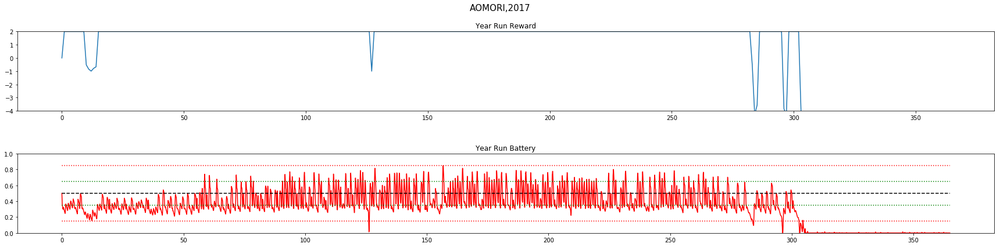

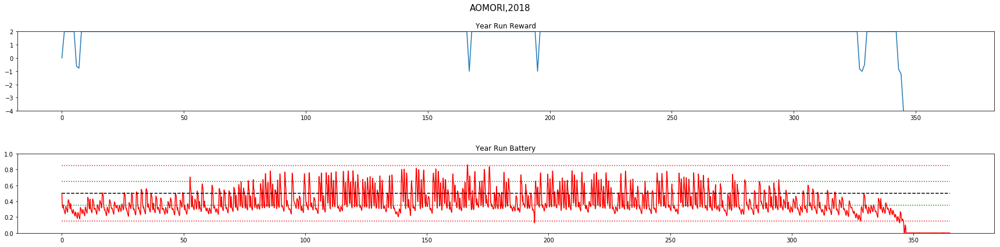



AOMORI
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 0.38		73	 1512
2001	 0.66		59	 1296
2002	 0.99		45	 968
2003	 1.4		25	 494
2004	 1.29		30	 665
2005	 0.48		66	 1390
2006	 0.84		50	 1130
2007	 -0.05		91	 1867
2008	 1.15		38	 807
2009	 0.83		51	 1159
2010	 1.3		31	 586
2011	 1.18		37	 676
2012	 1.06		44	 875
2013	 1.26		32	 613
2014	 0.91		48	 1065
2015	 1.12		37	 831
2016	 -0.48		112	 2302
2017	 0.49		68	 1388
2018	 1.49		23	 435

TOTAL Day Violations:   960.0
TOTAL Batt Violations:  20059.0
************************************


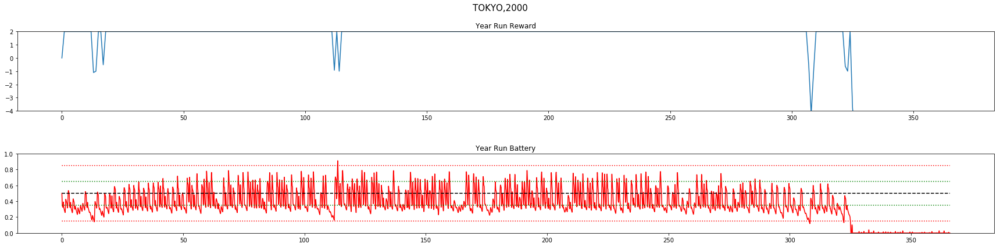

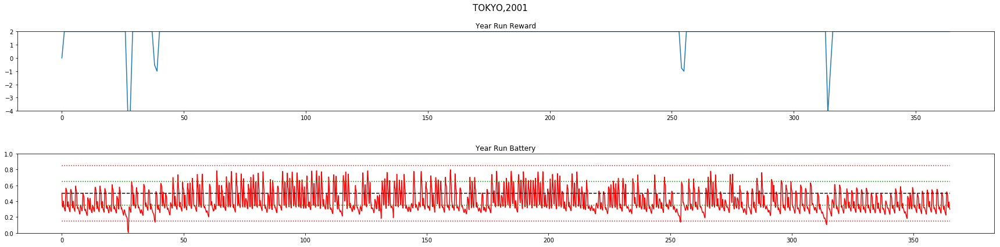

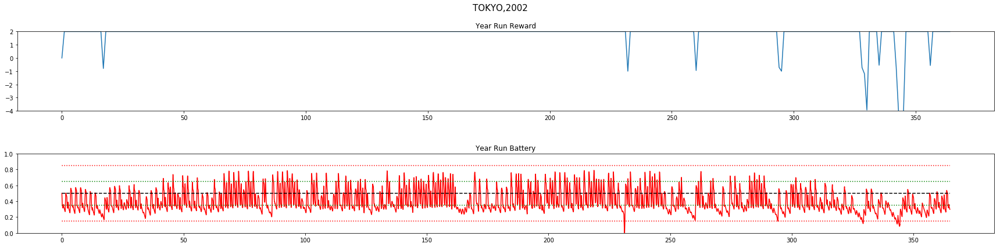

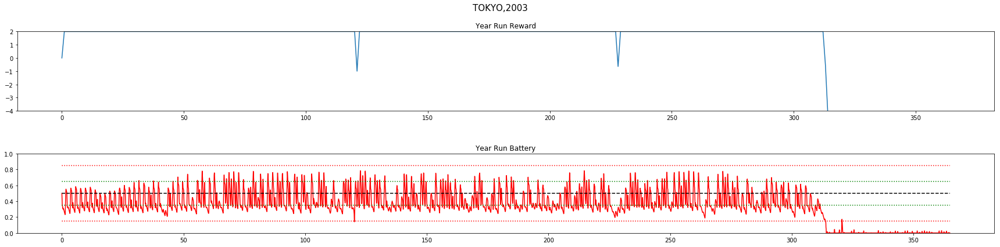

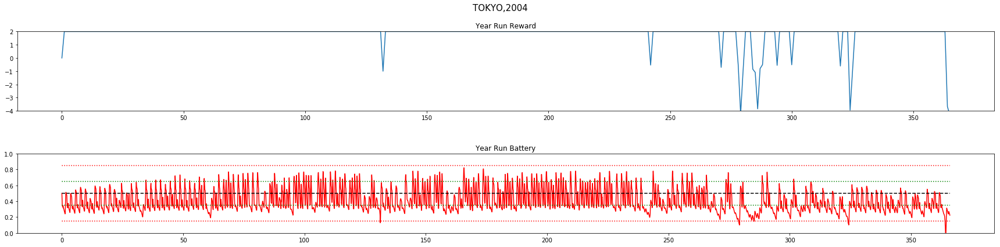

...

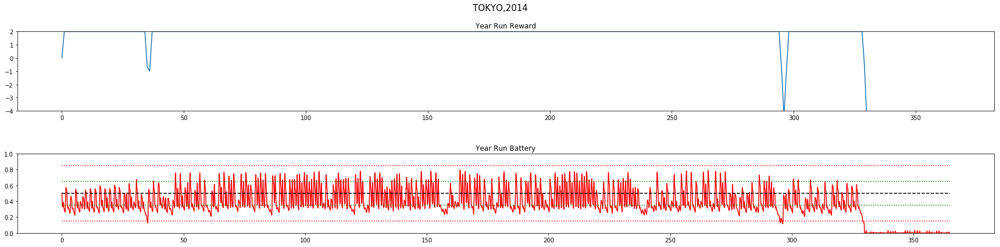

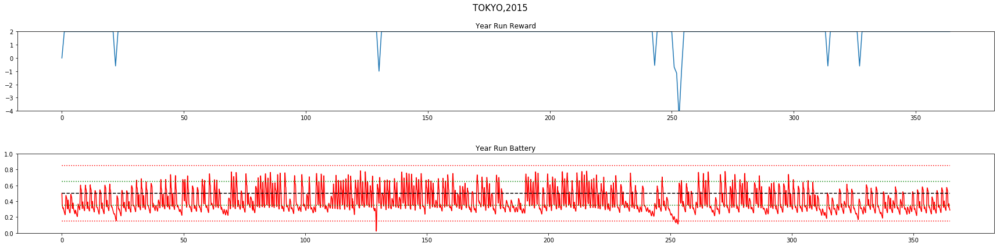

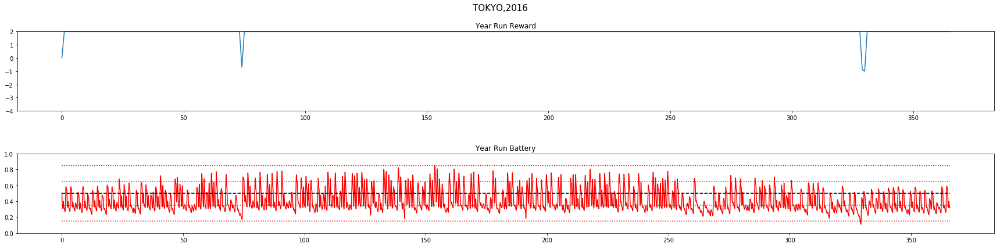

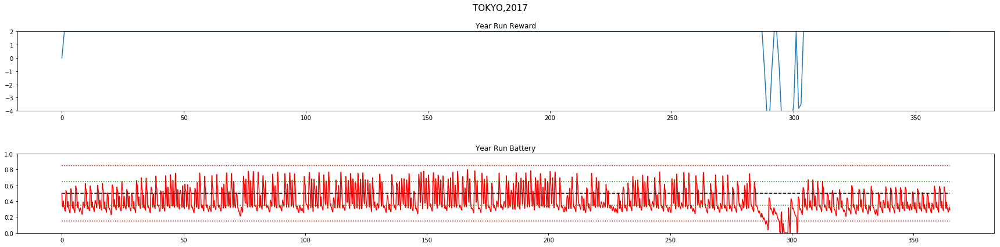

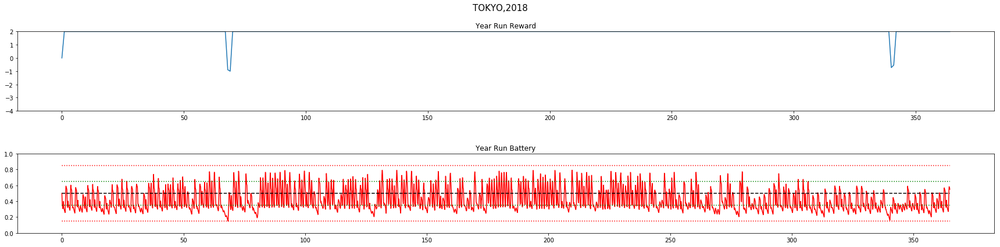



TOKYO
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 1.0		47	 877
2001	 1.9		6	 0
2002	 1.85		6	 2
2003	 0.83		53	 1064
2004	 1.81		8	 5
2005	 1.8		8	 68
2006	 1.34		32	 452
2007	 1.94		2	 0
2008	 0.25		81	 1462
2009	 1.85		9	 7
2010	 1.95		0	 0
2011	 1.97		1	 0
2012	 1.94		1	 0
2013	 1.94		3	 0
2014	 1.16		39	 745
2015	 1.92		3	 0
2016	 1.97		1	 0
2017	 1.79		11	 44
2018	 1.96		1	 0

TOTAL Day Violations:   312.0
TOTAL Batt Violations:  4726.0
************************************


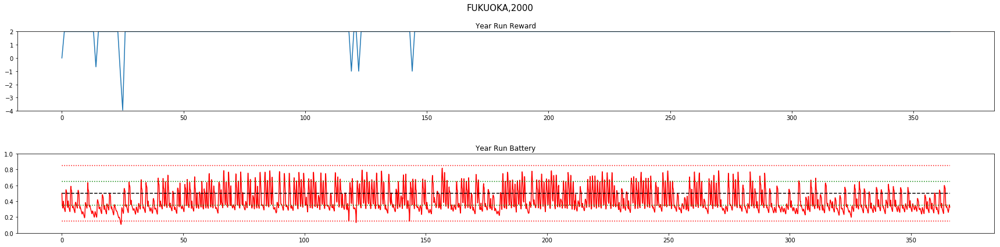

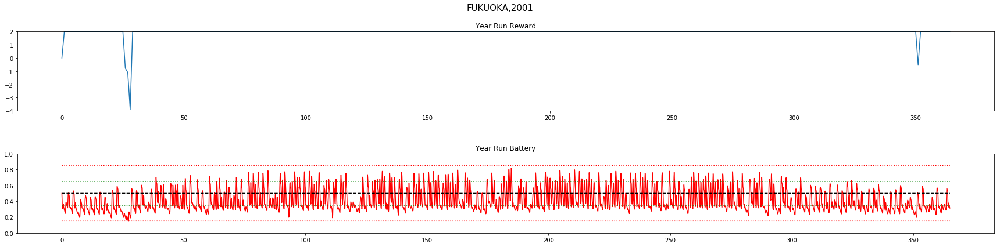

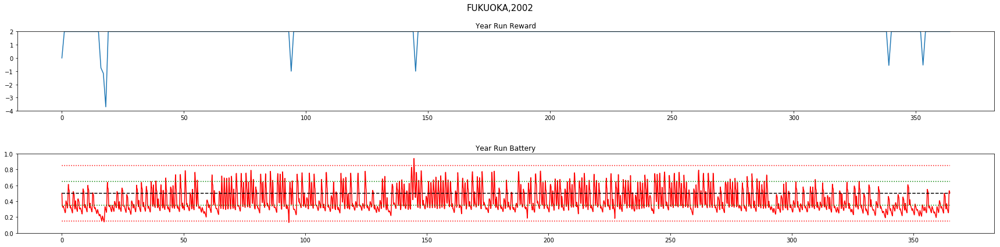

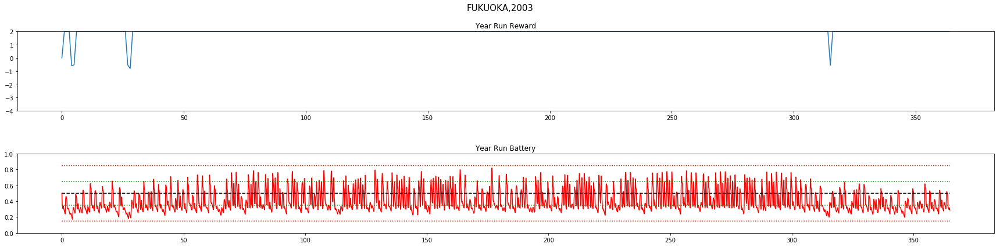

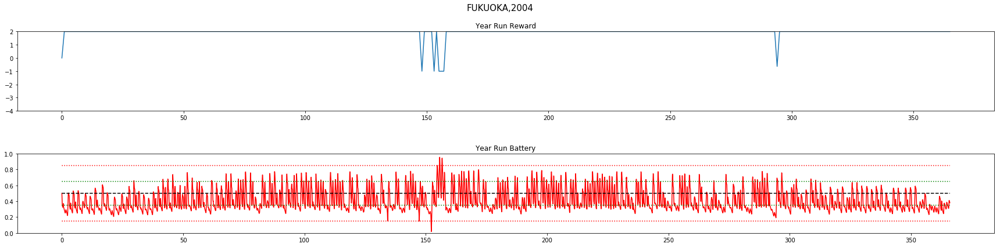

...

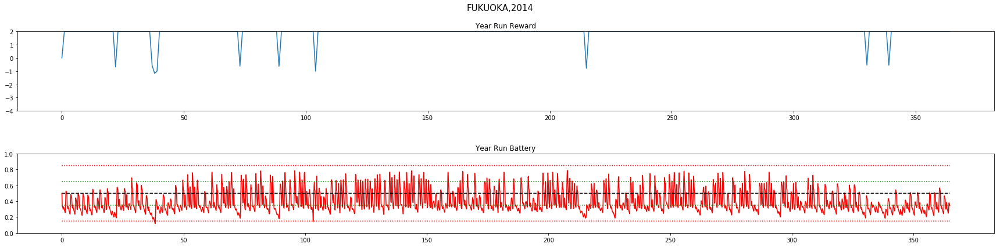

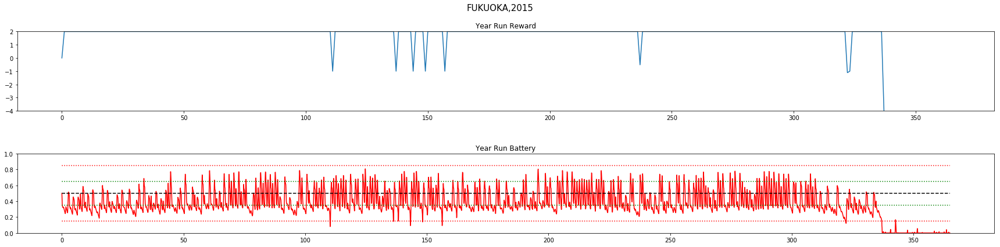

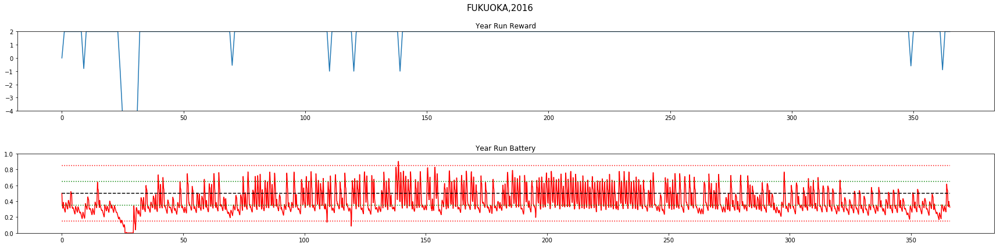

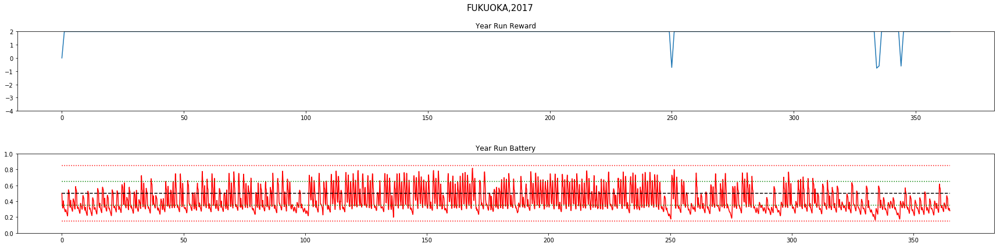

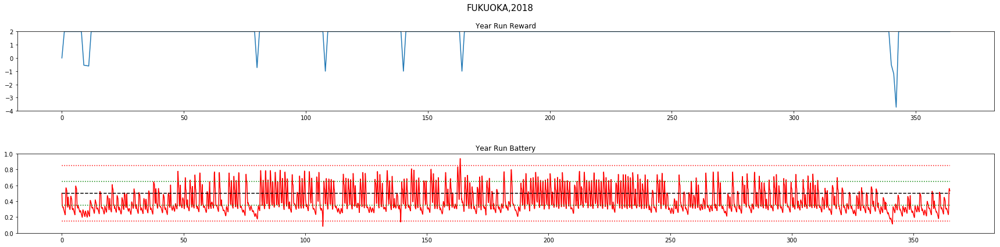



FUKUOKA
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 1.94		4	 0
2001	 1.96		1	 0
2002	 1.93		3	 0
2003	 1.96		0	 0
2004	 1.95		5	 0
2005	 1.88		5	 32
2006	 1.53		21	 352
2007	 1.89		4	 0
2008	 1.97		0	 0
2009	 1.16		41	 705
2010	 1.86		6	 5
2011	 1.38		28	 474
2012	 1.76		10	 186
2013	 1.91		2	 0
2014	 1.92		2	 0
2015	 1.31		35	 606
2016	 1.79		10	 81
2017	 1.97		0	 0
2018	 1.91		4	 0

TOTAL Day Violations:   181.0
TOTAL Batt Violations:  2441.0
************************************


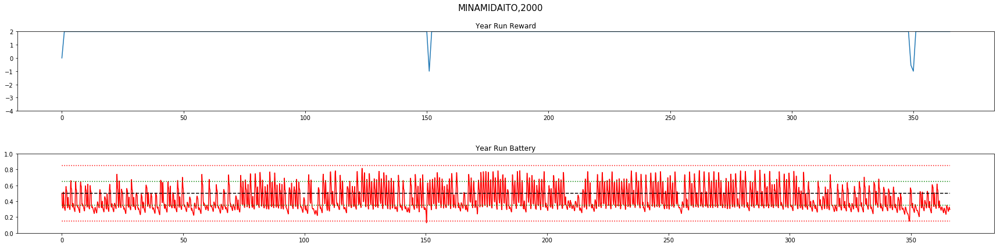

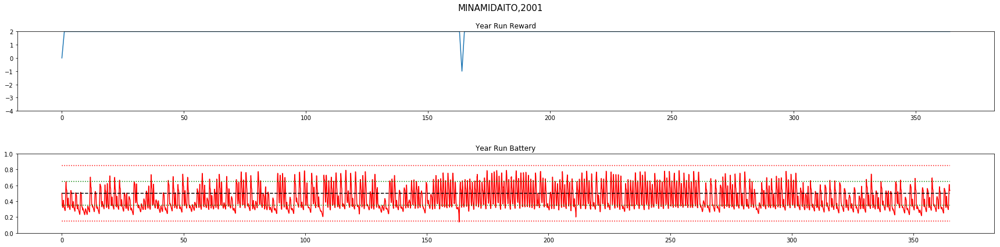

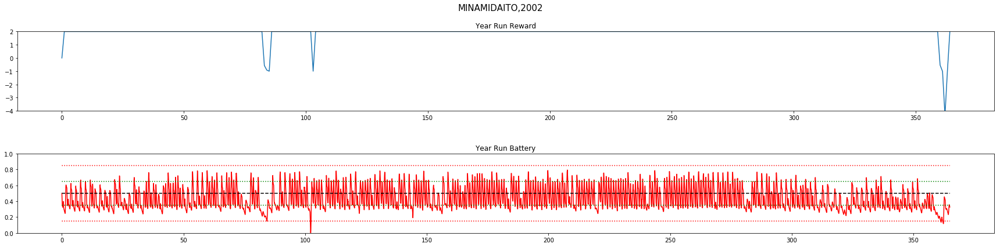

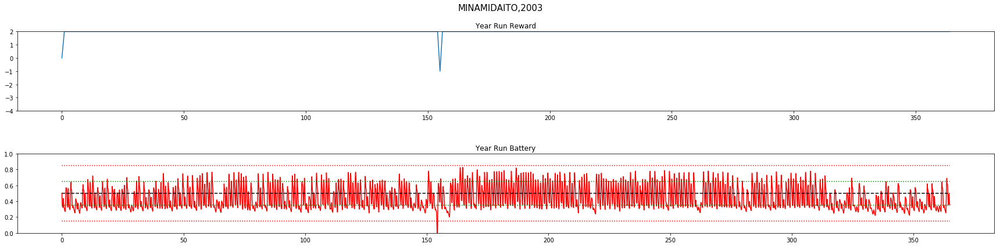

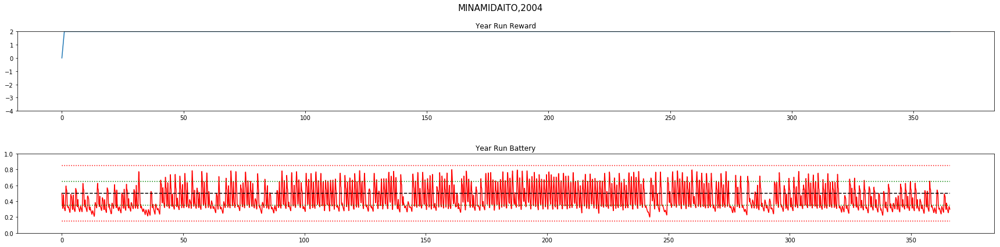

...

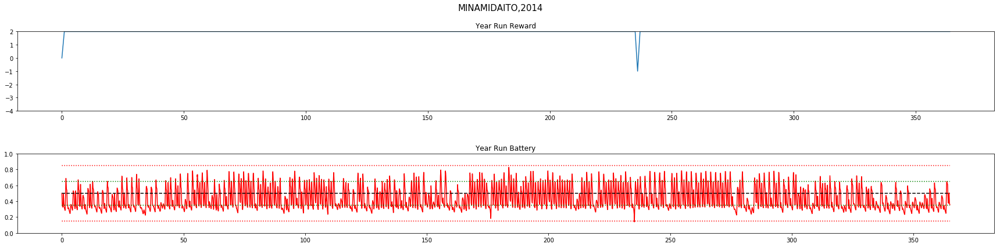

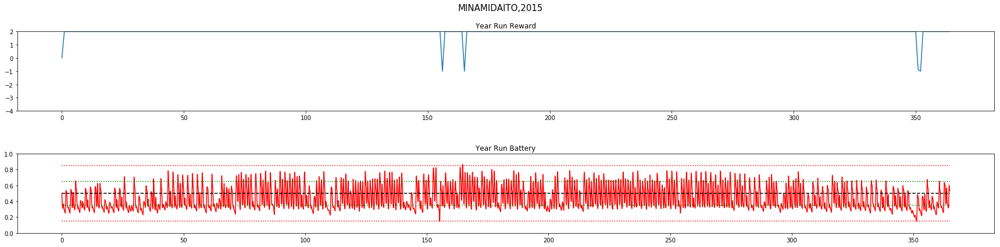

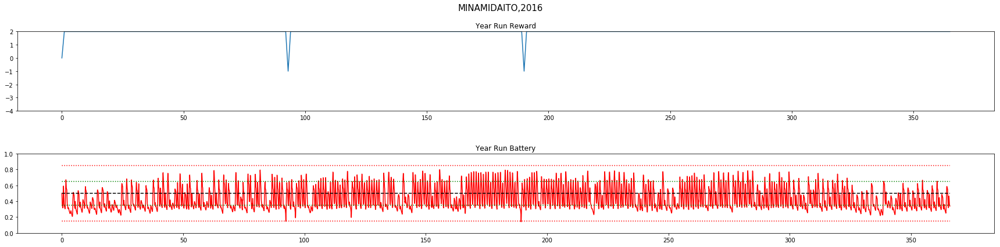

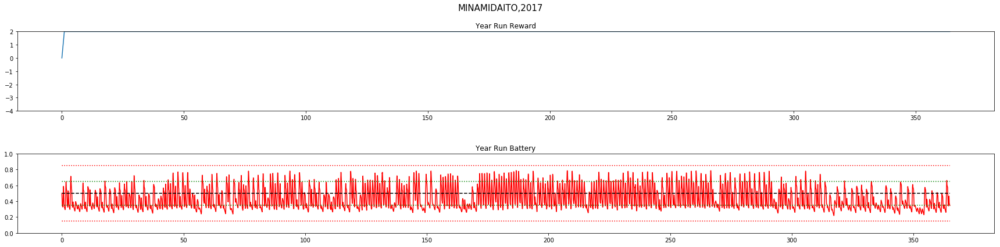

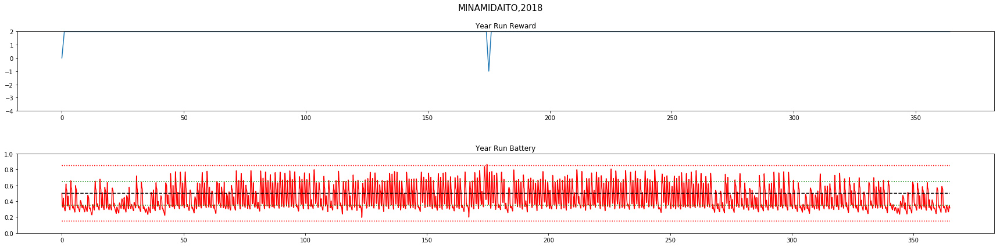



MINAMIDAITO
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 1.97		2	 0
2001	 1.99		1	 0
2002	 1.92		4	 1
2003	 1.99		1	 1
2004	 1.99		0	 0
2005	 1.87		5	 60
2006	 1.99		0	 0
2007	 1.98		2	 0
2008	 1.99		0	 0
2009	 1.91		4	 37
2010	 1.94		2	 0
2011	 1.97		1	 0
2012	 1.79		11	 136
2013	 1.99		1	 0
2014	 1.99		1	 0
2015	 1.96		3	 0
2016	 1.98		2	 0
2017	 1.99		0	 0
2018	 1.99		1	 0

TOTAL Day Violations:   41.0
TOTAL Batt Violations:  235.0
************************************


In [22]:
#VALIDATION PHASE
print("***MEASURING PERFORMANCE OF THE MODEL***")
for LOCATION in ['wakkanai','aomori','tokyo','fukuoka','minamidaito']:
    results = np.empty(4)

    for YEAR in np.arange(2000,2019):
        capm      = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
        capm.eno  = ENO(LOCATION,YEAR, shuffle=False, day_balance=False) #instantiate the environment inside the CAPM class
        capm.HMAX = capm.eno.SMAX #maximum power output of solar cell is set in CAPM object using the value in ENO object

        s, r, day_end, year_end = capm.reset()
        yr_test_record = np.empty(4)

        while True:
            a = dqn.choose_greedy_action(stdize(s))
            yr_test_record = np.vstack((yr_test_record, [s[0],s[2],r, a])) #record battery, henergy, reward and action
            s_, r, day_end, year_end = capm.step(a)
            if year_end:
                break
            s = s_

        yr_test_record = np.delete(yr_test_record, 0, 0) #remove the first row which is garbage
        yr_test_reward_rec = yr_test_record[:,2]
        yr_test_reward_rec = yr_test_reward_rec[::24] #annual average reward
        results = np.vstack((results, [int(YEAR), np.mean(yr_test_reward_rec), int(capm.violation_counter), int(capm.batt_violations)]))

    ###########################################################################################
    ###########################################################################################
        #     Plot the reward and battery for the entire year run
        title = LOCATION.upper() + ',' + str(YEAR)
        NO_OF_DAYS = capm.eno.NO_OF_DAYS

        fig = plt.figure(figsize=(24,6))
        fig.suptitle(title, fontsize=15)

        ax1 = fig.add_subplot(211)
        ax1.plot(yr_test_reward_rec)
        ax1.set_title("\n\nYear Run Reward")
        ax1.set_ylim([-4,2])

        ax2 = fig.add_subplot(212)
        ax2.plot(yr_test_record[:,0],'r')
        ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BOPT/capm.BMAX, 'k--')
        ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_LO/capm.BMAX, 'r:')
        ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_HI/capm.BMAX, 'r:')
        ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:')
        ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:')

        ax2.set_title("\n\nYear Run Battery")
        ax2.set_ylim([0,1])
        plt.sca(ax2)
        plt.xticks(np.arange(0, NO_OF_DAYS*24, 50*24),np.arange(0,NO_OF_DAYS,50))
        fig.tight_layout()
        plt.show()
    ###########################################################################################
    ###########################################################################################
    results = np.delete(results,0,0)
    print("\n")
    print(LOCATION.upper())
    print('YEAR\tAVG_RWD\t\tVIOLATIONS')
    print('\t\t\tDAY\tBATT')

    for x in np.arange(0,results.shape[0]):
        print('{}\t {}\t\t{}\t {}'.format(int(results[x,0]), np.around(results[x,1],2), int(results[x,2]), int(results[x,-1])))

    print("\nTOTAL Day Violations:  ",np.sum(results[:, 2]))
    print("TOTAL Batt Violations: ",np.sum(results[:,-1]))
    print("************************************")

In [23]:
print('\nRun time: {}'.format(datetime.now() - tic))


Run time: 0:28:11.960289


In [24]:
LOCATION = 'aomori'
YEAR = 2014

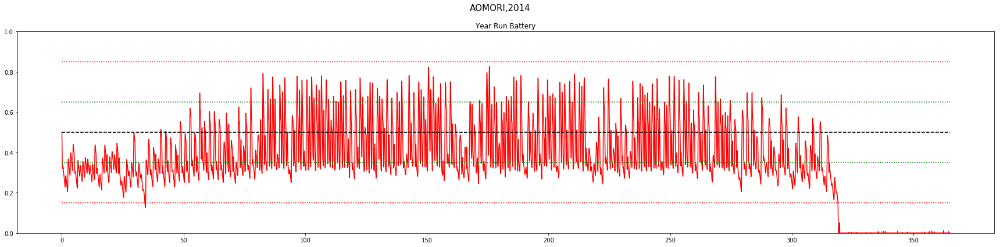

In [25]:
capm = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
capm.eno = ENO(LOCATION,YEAR, shuffle=False, day_balance=False) #instantiate the environment inside the CAPM class
capm.HMAX = capm.eno.SMAX #maximum power output of solar cell is set in CAPM object using the value in ENO object

s, r, day_end, year_end = capm.reset()
yr_test_record = np.empty(4)

while True:
    a = dqn.choose_greedy_action(stdize(s))

    #state = [batt, enp, henergy, fcast]
    yr_test_record = np.vstack((yr_test_record, [s[0],s[2],r, a])) #record battery, henergy, reward and action

    # take action
    s_, r, day_end, year_end = capm.step(a)

    if year_end:
        break

    s = s_

yr_test_record = np.delete(yr_test_record, 0, 0) #remove the first row which is garbage
yr_test_reward_rec = yr_test_record[:,2]
yr_test_reward_rec = yr_test_reward_rec[::24]

title = LOCATION.upper() + ',' + str(YEAR)
NO_OF_DAYS = capm.eno.NO_OF_DAYS

fig = plt.figure(figsize=(24,6))
fig.suptitle(title, fontsize=15)

#     ax1 = fig.add_subplot(211)
#     ax1.plot(yr_test_reward_rec)
#     ax1.set_title("\n\nYear Run Reward")
#     ax1.set_ylim([-3,3])

#Plot the reward and battery for the entire year run
ax2 = fig.add_subplot(111)
ax2.plot(yr_test_record[:,0],'r')
ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BOPT/capm.BMAX, 'k--')
ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_LO/capm.BMAX, 'r:')
ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_HI/capm.BMAX, 'r:')
ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:')
ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:')
ax2.set_title("\n\nYear Run Battery")
ax2.set_ylim([0,1])
plt.sca(ax2)
plt.xticks(np.arange(0, NO_OF_DAYS*24, 50*24),np.arange(0,NO_OF_DAYS,50))
fig.tight_layout()
plt.show()

In [26]:
DAY_START = 325
DAY_END   = 350

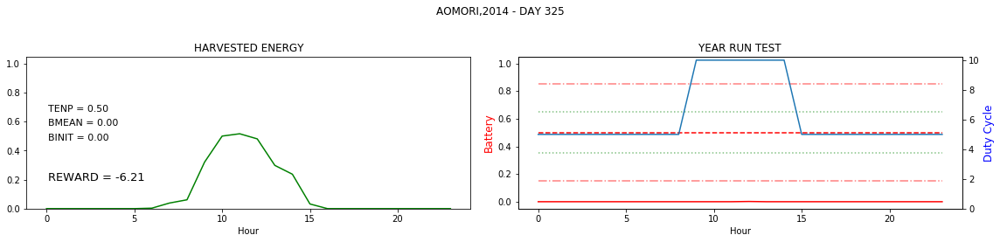

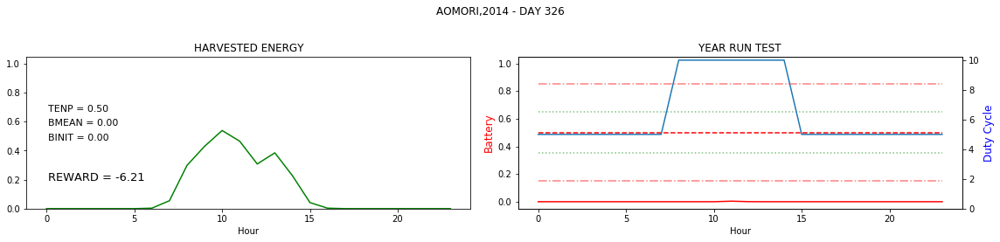

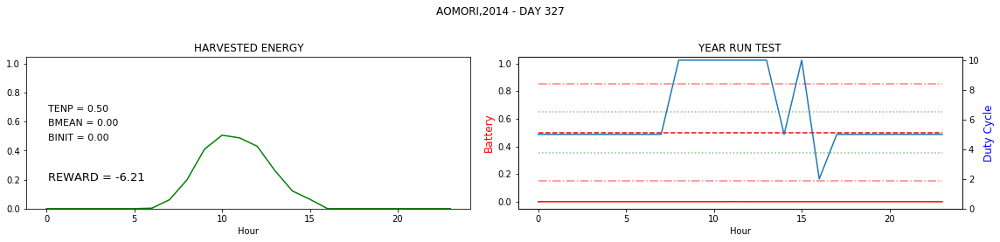

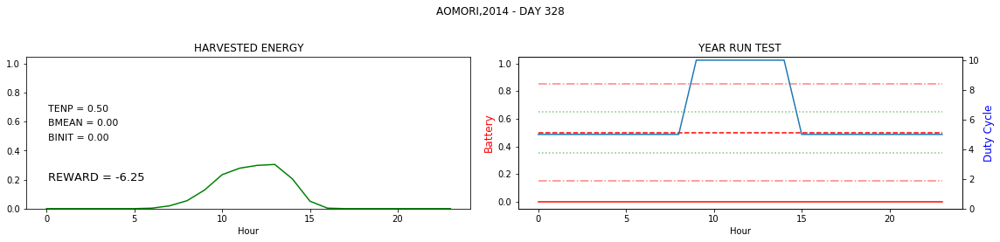

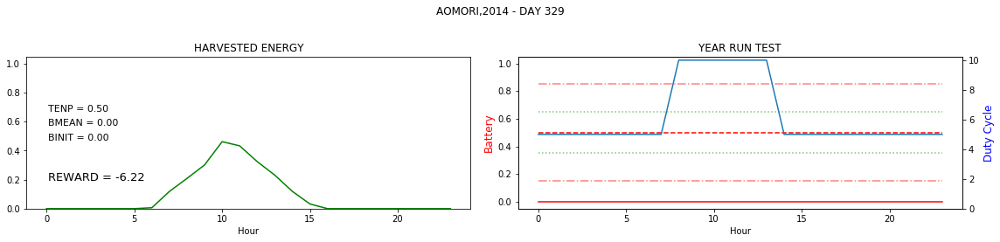

...

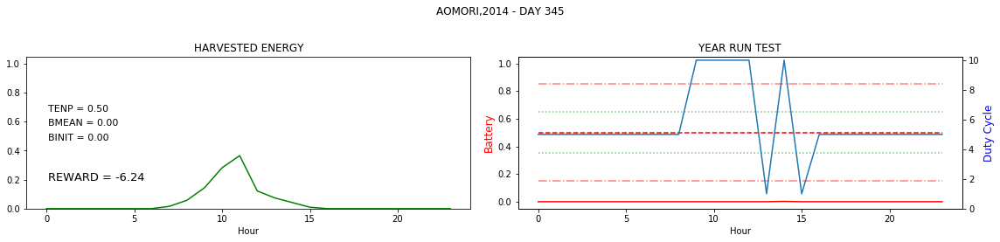

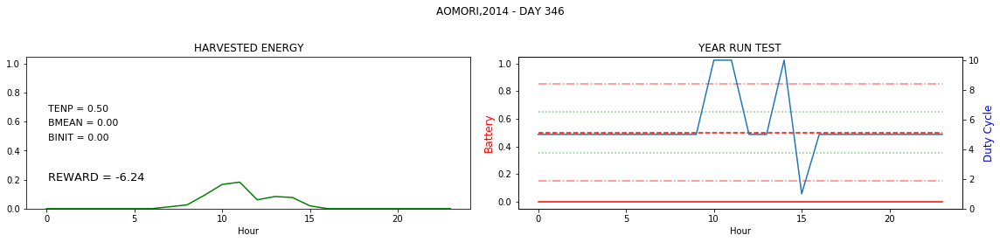

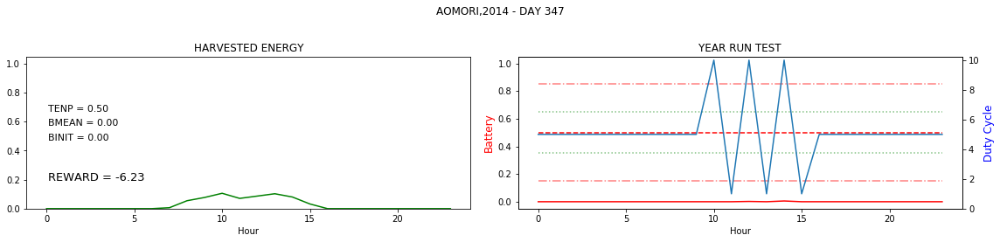

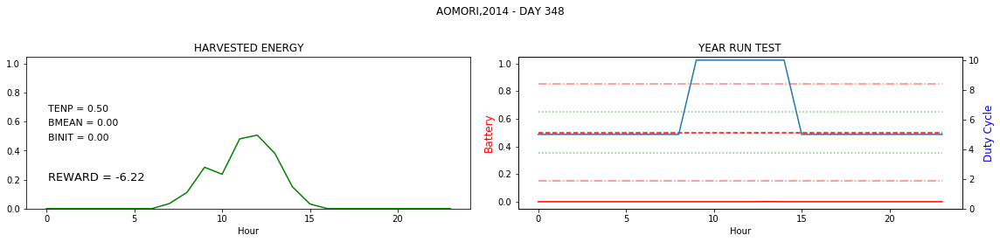

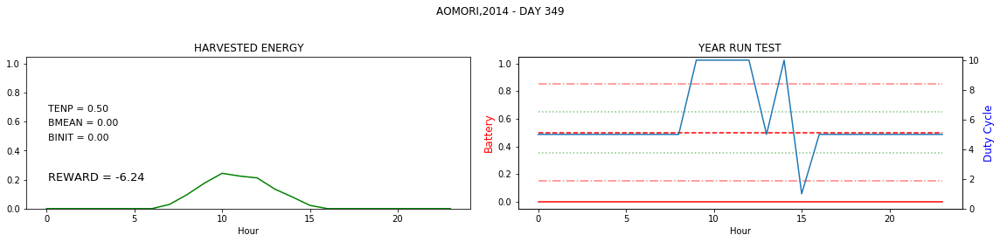

In [27]:
#Plot the reward and battery for the entire year run on a day by day basis
title = LOCATION.upper() + ',' + str(YEAR)
TIME_AXIS = np.arange(0,capm.eno.TIME_STEPS)
for DAY in range(DAY_START,DAY_END):
    START = DAY*24
    END = START+24

    daytitle = title + ' - DAY ' + str(DAY)
    fig = plt.figure(figsize=(16,4))
    st = fig.suptitle(daytitle)

    ax2 = fig.add_subplot(121)
    ax2.plot(yr_test_record[START:END,1],'g')
    ax2.set_title("HARVESTED ENERGY")
    ax2.set_xlabel("Hour")
    ax2.set_ylim([0,1.05])
    
    ax2.text(0.1, 0.6, "TENP = %.2f\n" %(capm.BOPT/capm.BMAX-yr_test_record[END,0]),fontsize=11, ha='left')
    ax2.text(0.1, 0.5, "BMEAN = %.2f\n" %(np.mean(yr_test_record[START:END,0])),fontsize=11, ha='left')
    ax2.text(0.1, 0.4, "BINIT = %.2f\n" %(yr_test_record[START,0]),fontsize=11, ha='left')
    if END < (capm.eno.NO_OF_DAYS*capm.eno.TIME_STEPS):
        ax2.text(0.1, 0.1, "REWARD = %.2f\n" %(yr_test_record[END,2]),fontsize=13, ha='left')
        
    #plot battery for year run
    ax1 = fig.add_subplot(122)
    ax1.plot(TIME_AXIS,              yr_test_record[START:END,0],'r')
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*capm.BOPT/capm.BMAX, 'r--')
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*capm.BLIM_LO/capm.BMAX, 'r-.',alpha=0.5)
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*capm.BLIM_HI/capm.BMAX, 'r-.',alpha=0.5)
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:',alpha=0.5)
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:',alpha=0.5)
    
    ax1.set_title("YEAR RUN TEST")
    ax1.set_xlabel("Hour")
    ax1.set_ylabel('Battery', color='r',fontsize=12)
    ax1.set_ylim([-0.05,1.05])

    #plot actions for year run
    ax1a = ax1.twinx()
    ax1a.plot(yr_test_record[START:END,3]+1)
    ax1a.set_ylim([0,N_ACTIONS])
    ax1a.set_ylabel('Duty Cycle', color='b',fontsize=12)
    ax1a.set_ylim([0,10.25])


    fig.tight_layout()
    st.set_y(0.95)
    fig.subplots_adjust(top=0.75)
    plt.show()